In [ ]:
# Install ultralytics and torch libraries if not installed
!pip install ultralytics
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121

# Import necessary libraries
from ultralytics import YOLO  # Import the YOLO class from ultralytics
import torch  # Import torch for device selection

# Check if CUDA is available and set device accordingly
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

# Load a pre-trained YOLO model
model = YOLO("yolo11n.pt") # Now the YOLO class should be defined and accessible

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 52.7 MB/s eta 0:00:00
Looking in indexes: https://download.pytorch.org/whl/cu121
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Using device: cuda


100%|██████████| 5.35M/5.35M [00:00<00:00, 275MB/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Train the model on your dataset
train_results = model.train(
    data="/content/drive/MyDrive/LicensePlate_dataset/data.yaml",  # Path to your dataset YAML file
    epochs=32,  # Number of training epochs
    imgsz=640,  # Training image size
    device=device,  # Use the determined device (GPU or CPU)
)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/drive/MyDrive/LicensePlate_dataset/data.yaml, epochs=128, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, 

100%|██████████| 755k/755k [00:00<00:00, 85.2MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/MyDrive/LicensePlate_dataset/train/labels.cache... 7057 images, 15 backgrounds, 0 corrupt: 100%|██████████| 7067/7067 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/LicensePlate_dataset/valid/labels.cache... 2048 images, 23 backgrounds, 0 corrupt: 100%|██████████| 2068/2068 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 128 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/128      2.34G      1.244      1.861        1.2         24        640: 100%|██████████| 442/442 [48:35<00:00,  6.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 65/65 [00:27<00:00,  2.34it/s]


                   all       2068       2195      0.954      0.901      0.932      0.574


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


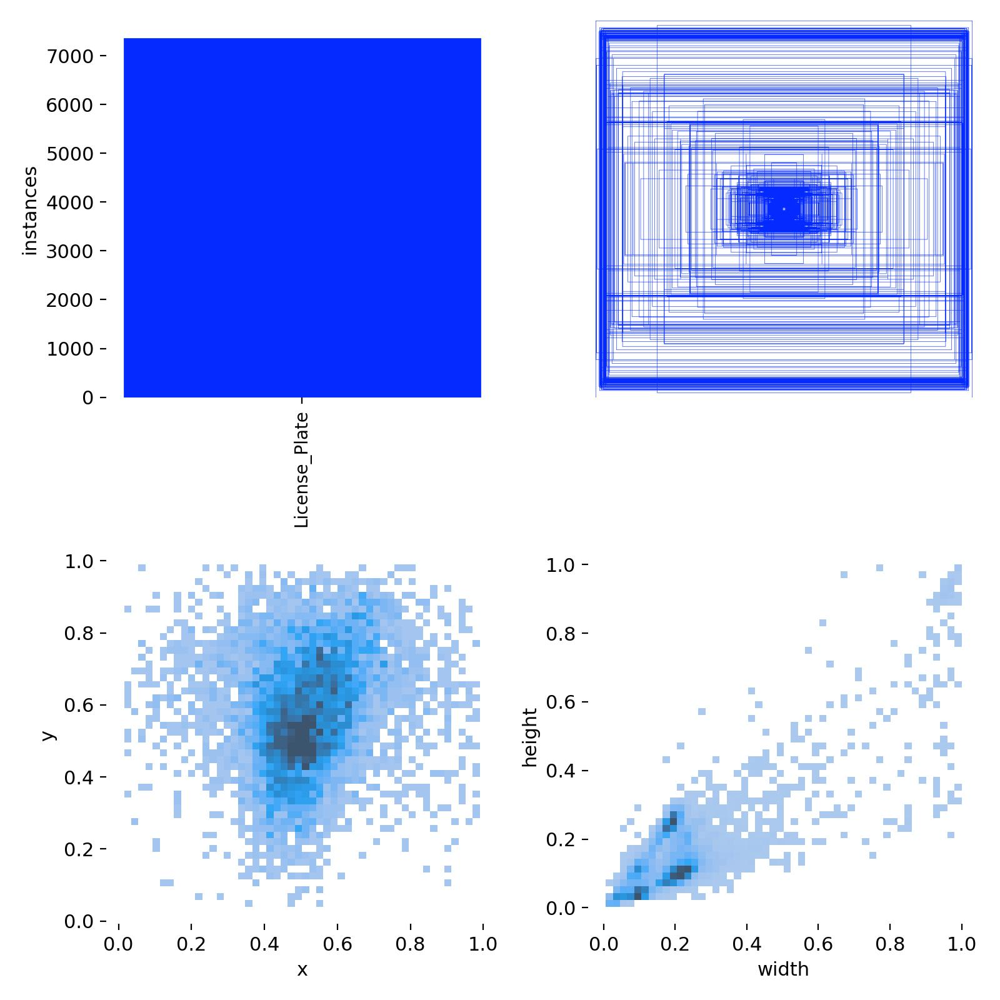

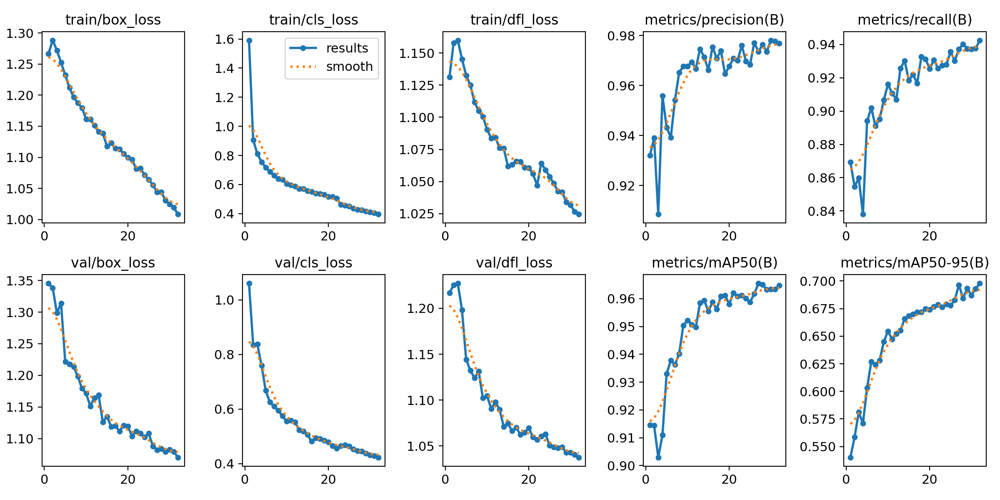

In [ ]:
from google.colab import drive
from IPython.display import display
from PIL import Image

# Define a list of image paths
image_paths = [
    '/content/drive/MyDrive/Detection_License_Plate_model/labels.jpg',
    '/content/drive/MyDrive/Detection_License_Plate_model/results.png'
    # Add more image paths as needed
]

# Display each image using a loop
for path in image_paths:
  img = Image.open(path)
  display(img)

In [ ]:
# Install ultralytics and torch libraries if not installed
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip install git+https://github.com/ultralytics/ultralytics.git@main
!pip install easyocr

# Import necessary libraries
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import io
import os
import requests
import easyocr
from PIL import Image

# Check if CUDA is available and set device accordingly
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

# Load a pre-trained YOLO model (placeholder for now)
model = YOLO("yolo11n.pt")  # Optional, for reference

# Mount Google Drive (Optional)
from google.colab import drive
drive.mount('/content/drive')

# Load your custom model
model = YOLO("/content/drive/MyDrive/Detection_License_Plate_model/best.pt")

Looking in indexes: https://download.pytorch.org/whl/cu121
  Cloning https://github.com/ultralytics/ultralytics.git (to revision main) to /tmp/pip-req-build-el5sxq7_
  Running command git clone --filter=blob:none --quiet https://github.com/ultralytics/ultralytics.git /tmp/pip-req-build-el5sxq7_
  Resolved https://github.com/ultralytics/ultralytics.git to commit 3d52c4fa106dfe3da037dea0d2e370f984ca367f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.3.47-py3-none-any.whl size=898823 sha256=4cd0355f07b56decf11e704ded4d4e549e6a9ec695b7ecf51a4c2cbd233ed87f
  Stored in directory: /tmp/pip-ephem-wheel-cache-xub2rh33/wheels/60/db/e5/6abbdd13b4e3d5e2fdcd87690cd8738f842eeb37142fdccb5b
Successfully built ultralytics
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 72.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 27.5 

100%|██████████| 5.35M/5.35M [00:00<00:00, 237MB/s]


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).



0: 320x640 2 License_Plates, 458.0ms
Speed: 6.3ms preprocess, 458.0ms inference, 2.6ms postprocess per image at shape (1, 3, 320, 640)
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_detected_plates.txt

0: 448x640 1 License_Plate, 241.6ms
Speed: 5.8ms preprocess, 241.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_detected_plates.txt

0: 640x448 1 License_Plate, 268.0ms
Speed: 5.2ms preprocess, 268.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 448)
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sa

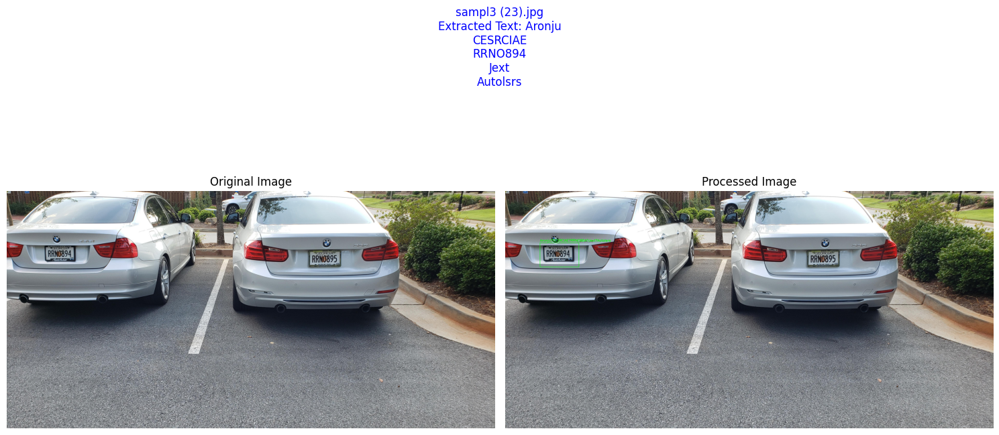

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_detected_plates.txt

0: 448x640 1 License_Plate, 267.3ms
Speed: 2.5ms preprocess, 267.3ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


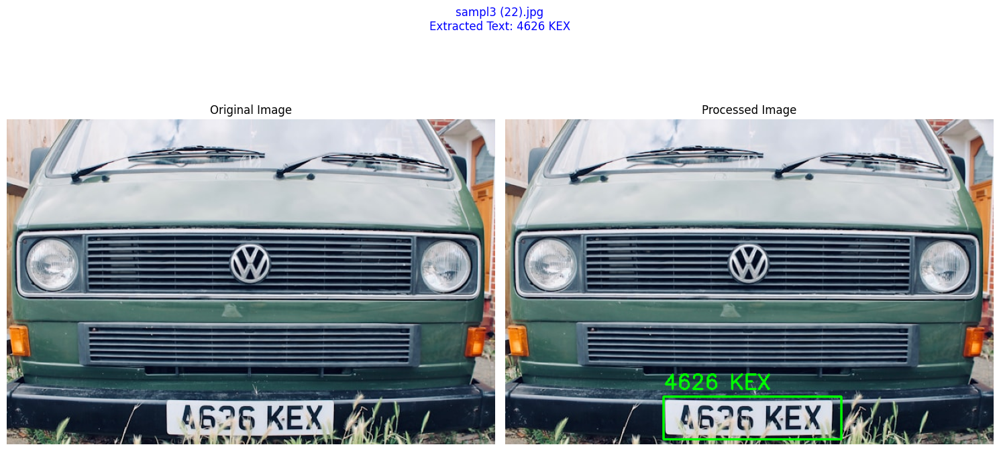

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_detected_plates.txt

0: 640x448 1 License_Plate, 270.6ms
Speed: 5.2ms preprocess, 270.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 448)


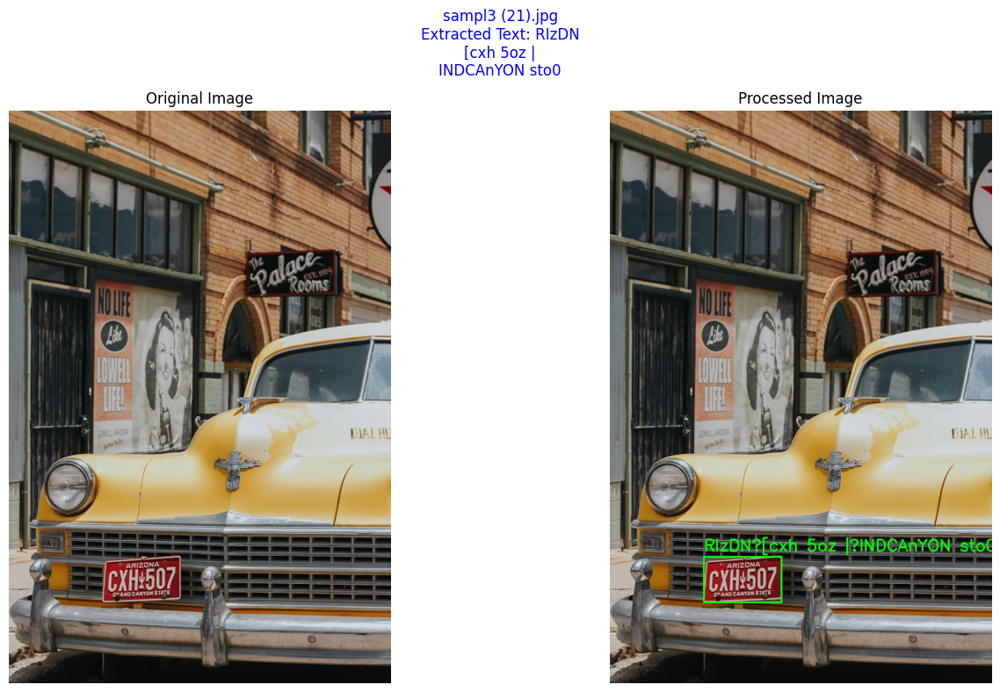

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (21)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (21)_detected_plates.txt

0: 640x448 1 License_Plate, 217.3ms
Speed: 4.4ms preprocess, 217.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)


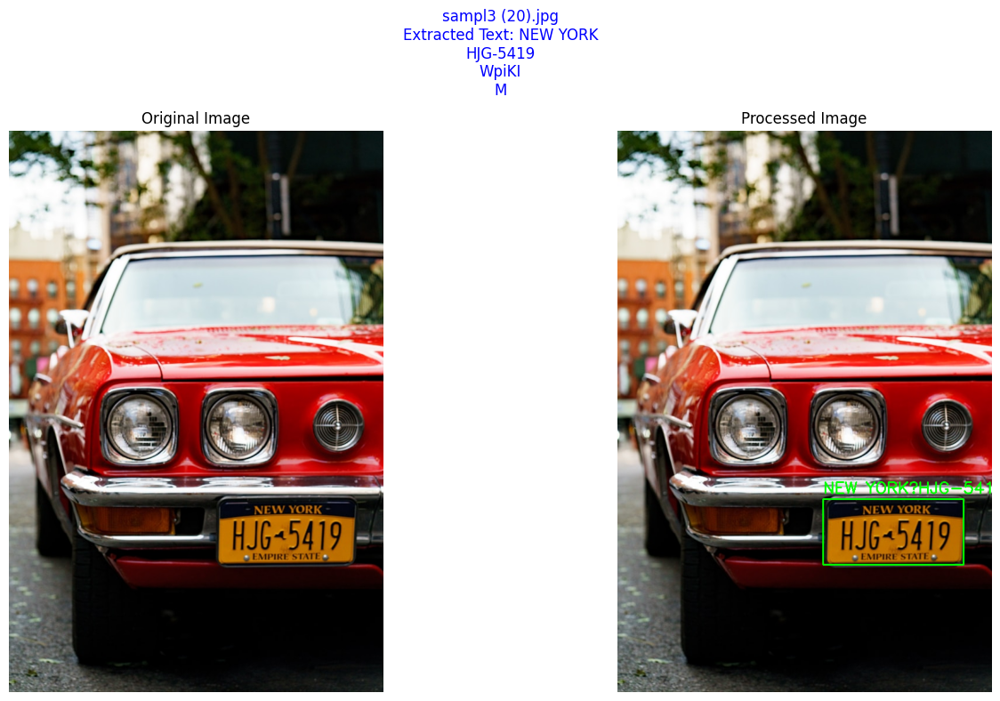

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (20)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (20)_detected_plates.txt

0: 640x448 2 License_Plates, 212.7ms
Speed: 4.6ms preprocess, 212.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)


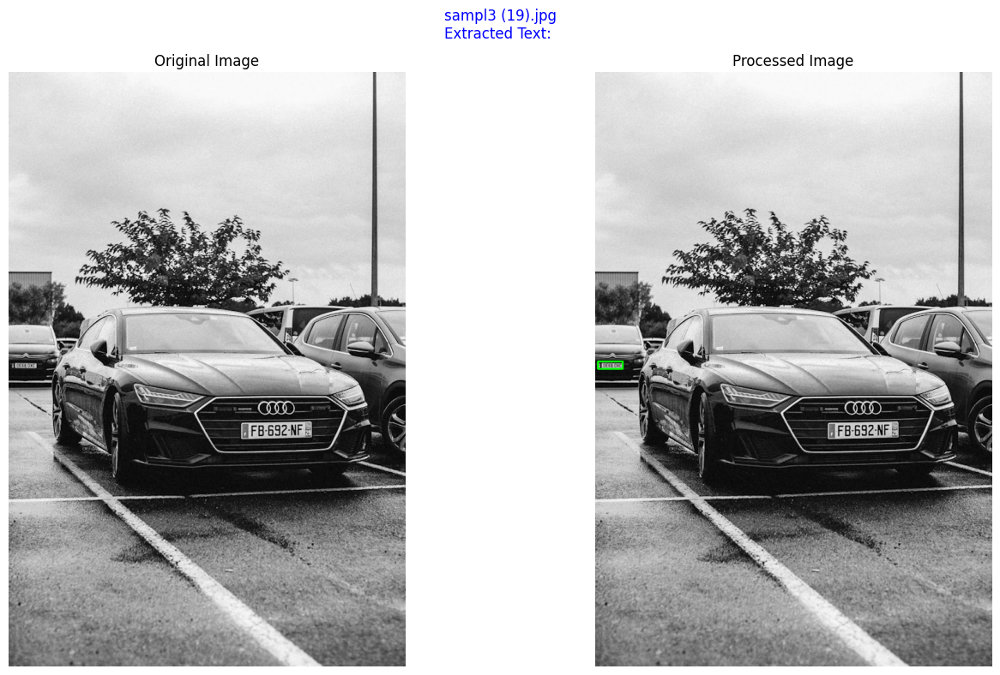

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (19)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (19)_detected_plates.txt

0: 640x448 1 License_Plate, 263.4ms
Speed: 5.3ms preprocess, 263.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)


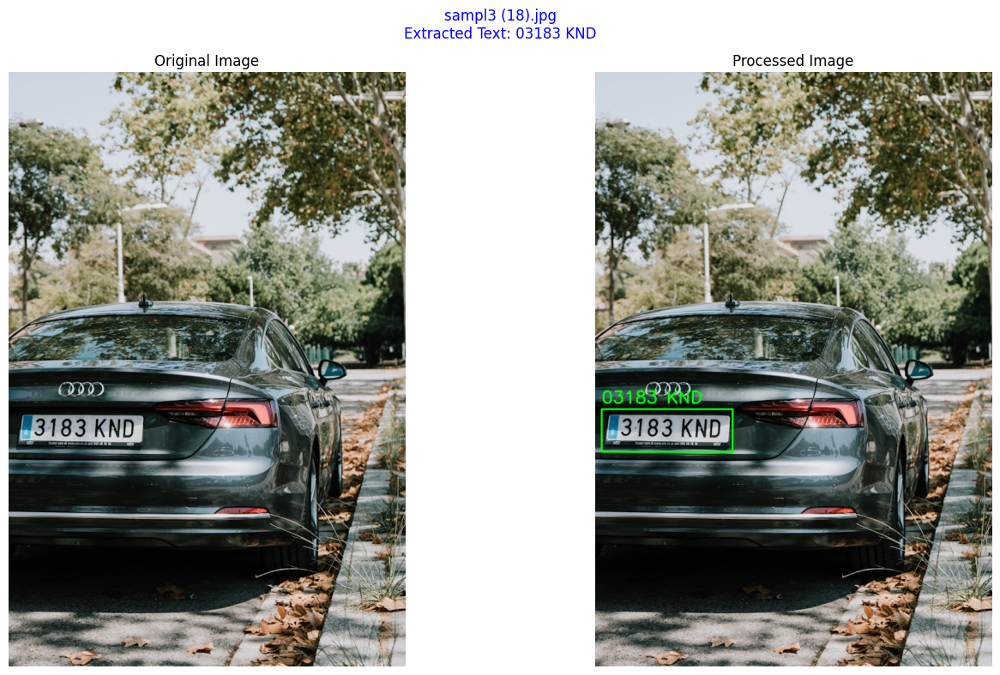

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (18)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (18)_detected_plates.txt

0: 448x640 2 License_Plates, 238.8ms
Speed: 7.6ms preprocess, 238.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


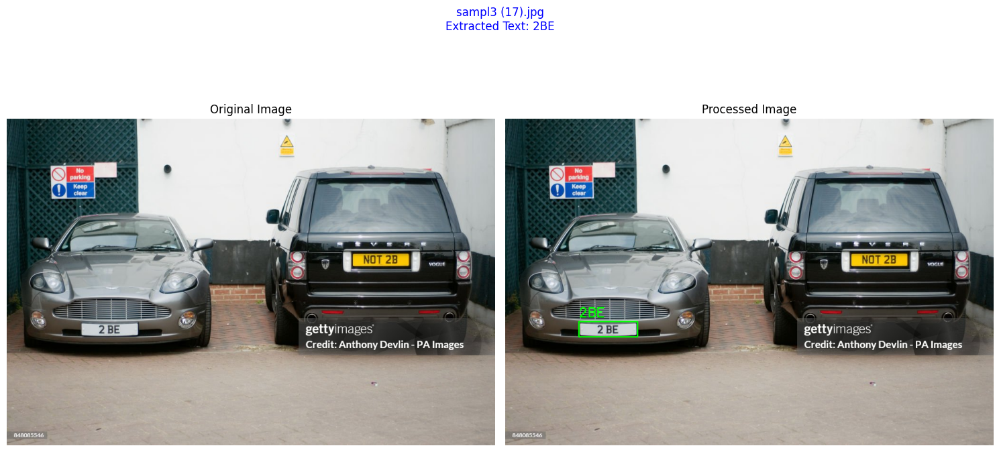

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (17)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (17)_detected_plates.txt

0: 640x640 2 License_Plates, 370.6ms
Speed: 8.1ms preprocess, 370.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


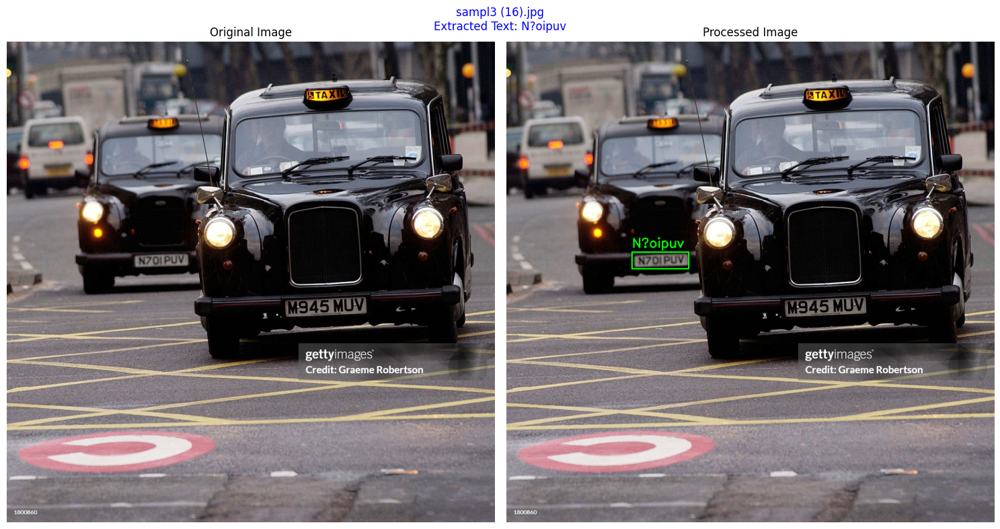

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (16)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (16)_detected_plates.txt

0: 352x640 2 License_Plates, 213.7ms
Speed: 4.3ms preprocess, 213.7ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)


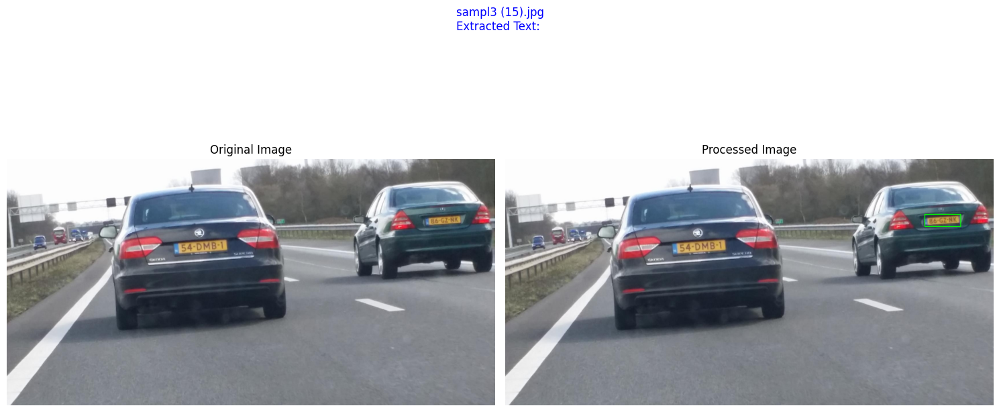

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (15)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (15)_detected_plates.txt

0: 448x640 1 License_Plate, 240.6ms
Speed: 4.6ms preprocess, 240.6ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)


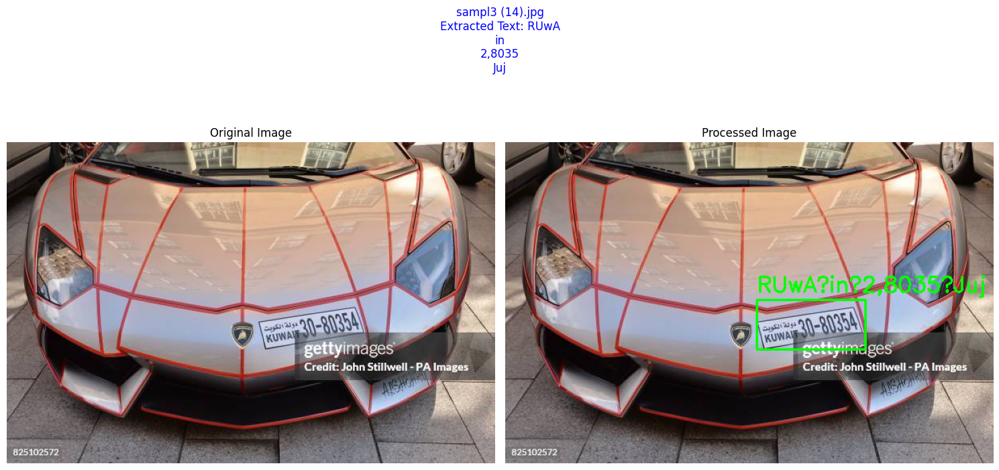

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (14)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (14)_detected_plates.txt

0: 448x640 1 License_Plate, 237.5ms
Speed: 5.0ms preprocess, 237.5ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


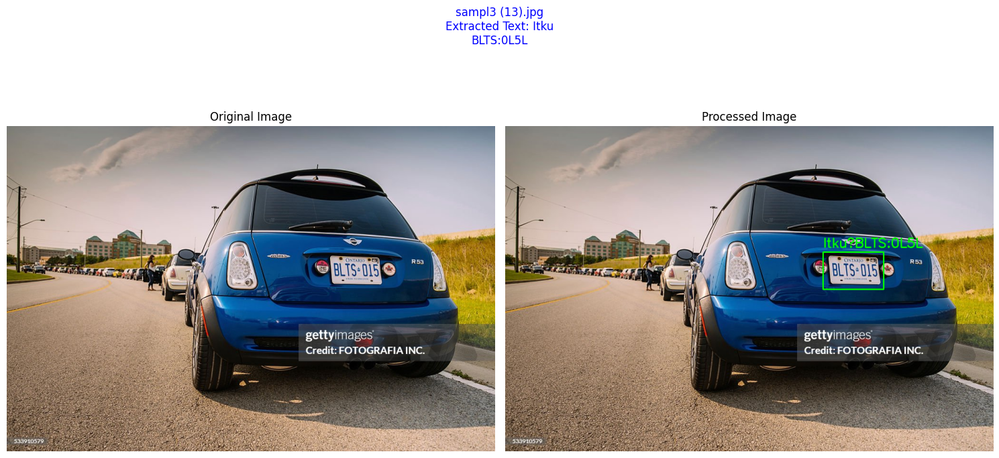

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (13)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (13)_detected_plates.txt

0: 640x512 1 License_Plate, 285.1ms
Speed: 5.5ms preprocess, 285.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)


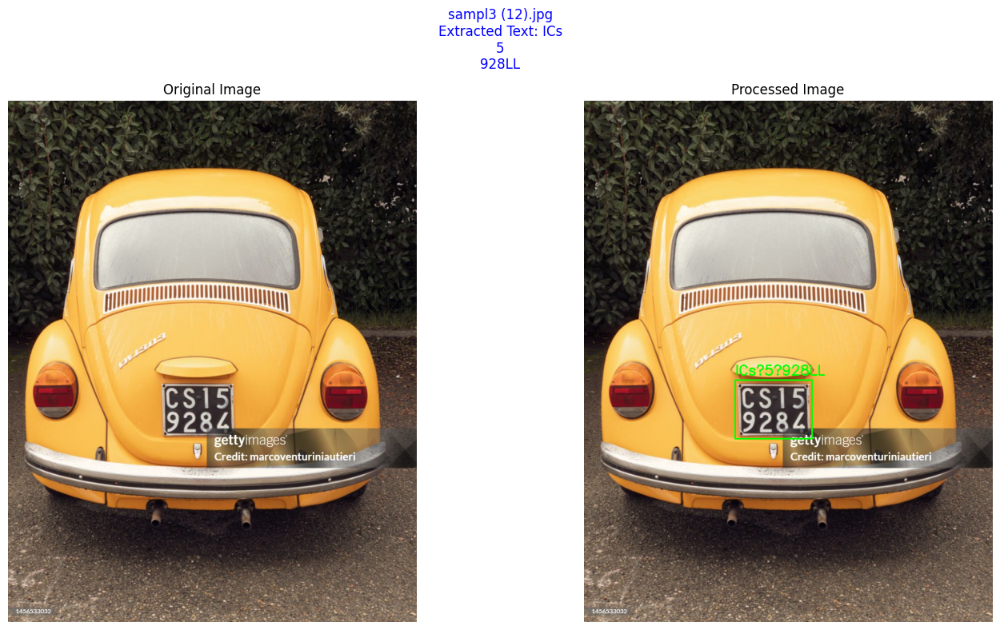

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (12)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (12)_detected_plates.txt

0: 512x640 1 License_Plate, 267.8ms
Speed: 4.8ms preprocess, 267.8ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)


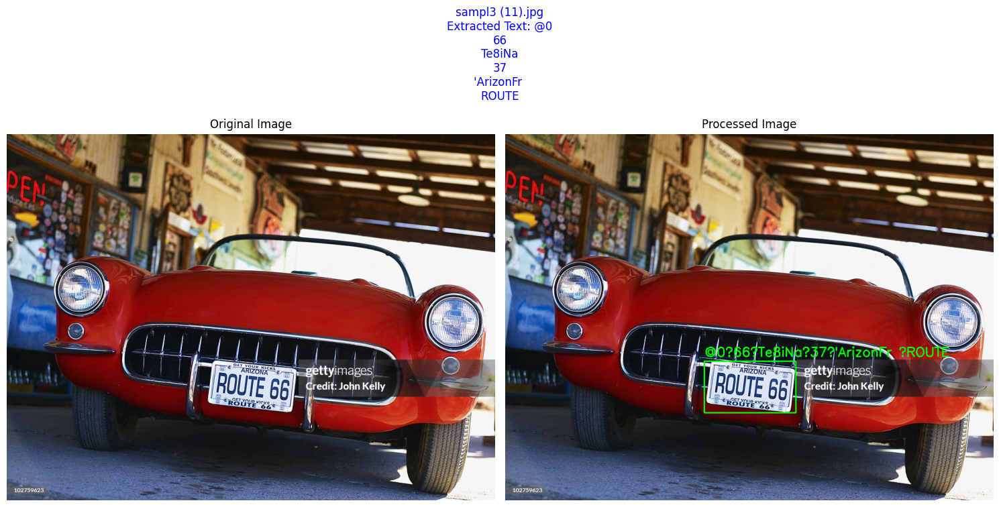

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (11)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (11)_detected_plates.txt

0: 448x640 2 License_Plates, 237.2ms
Speed: 5.5ms preprocess, 237.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


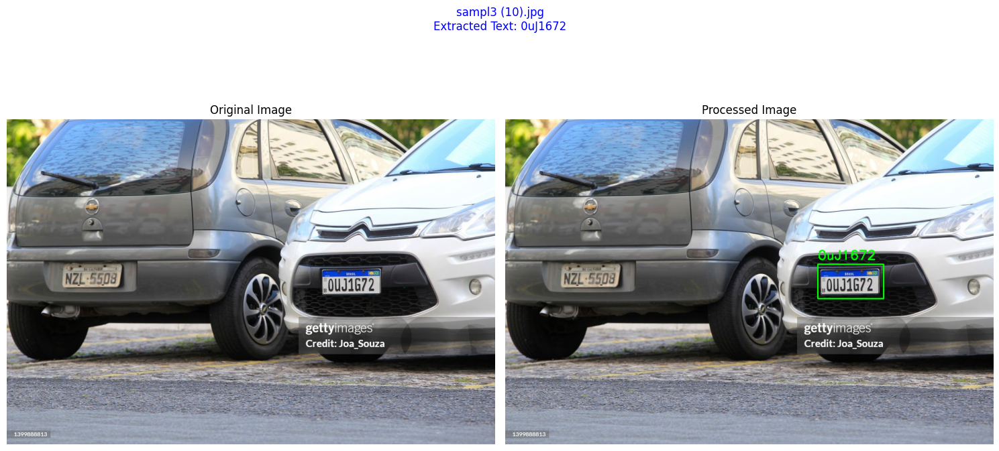

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (10)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (10)_detected_plates.txt

0: 448x640 2 License_Plates, 244.2ms
Speed: 4.8ms preprocess, 244.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


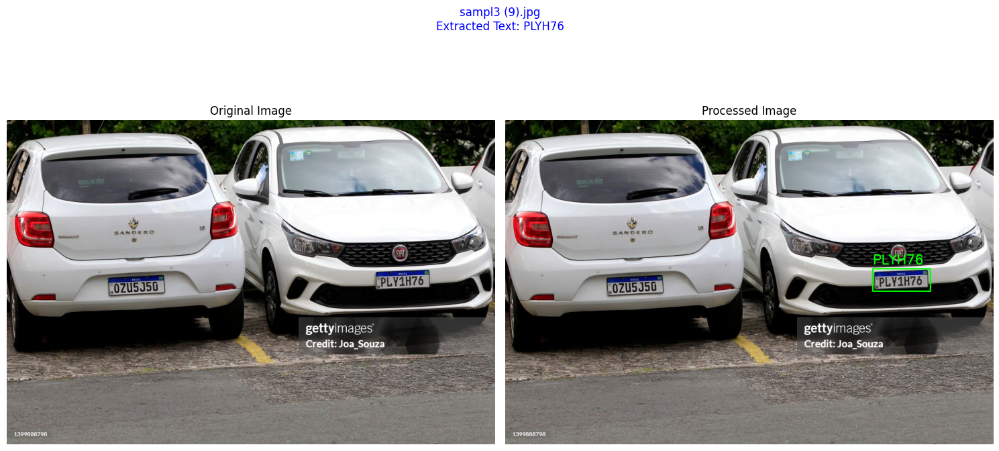

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (9)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (9)_detected_plates.txt

0: 448x640 2 License_Plates, 253.3ms
Speed: 4.5ms preprocess, 253.3ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


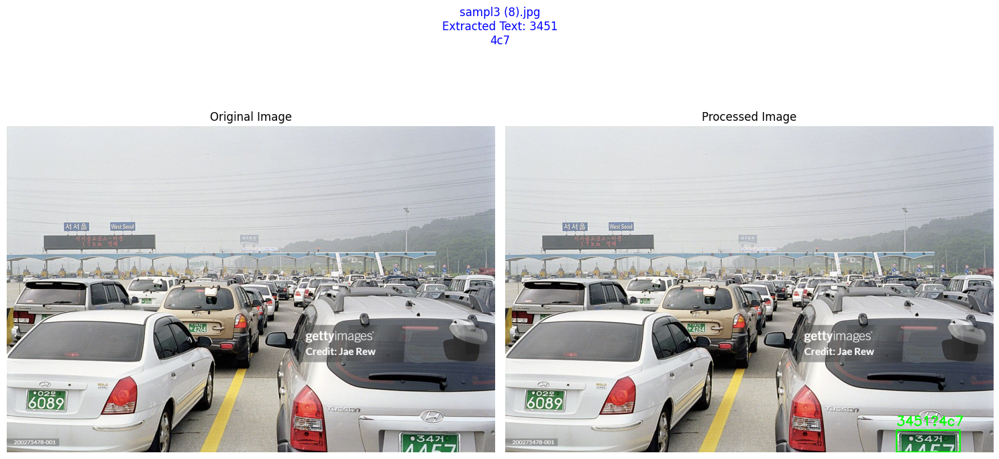

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (8)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (8)_detected_plates.txt

0: 448x640 1 License_Plate, 271.7ms
Speed: 5.7ms preprocess, 271.7ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


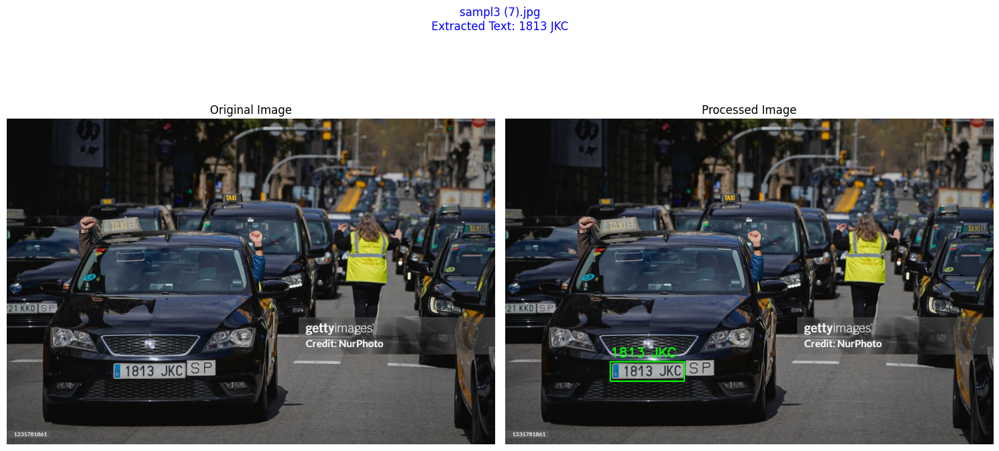

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (7)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (7)_detected_plates.txt

0: 448x640 1 License_Plate, 344.5ms
Speed: 9.9ms preprocess, 344.5ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


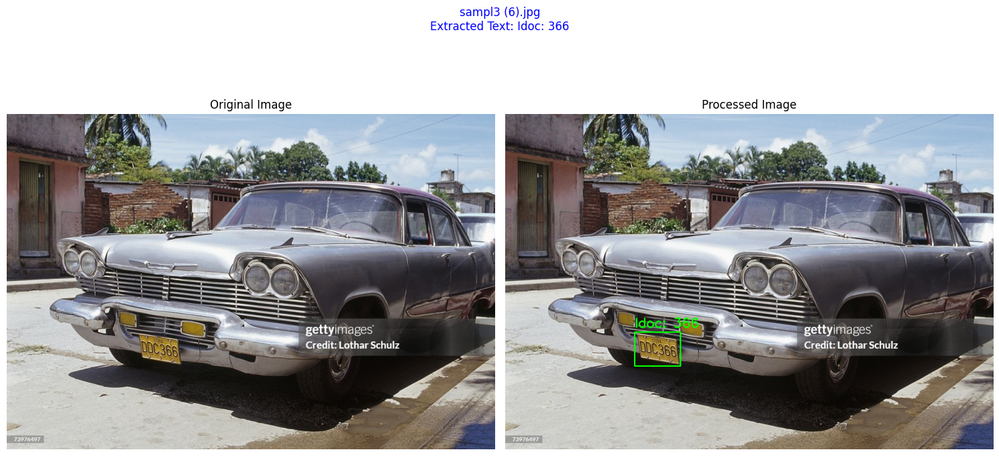

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (6)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (6)_detected_plates.txt

0: 448x640 1 License_Plate, 276.8ms
Speed: 8.0ms preprocess, 276.8ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


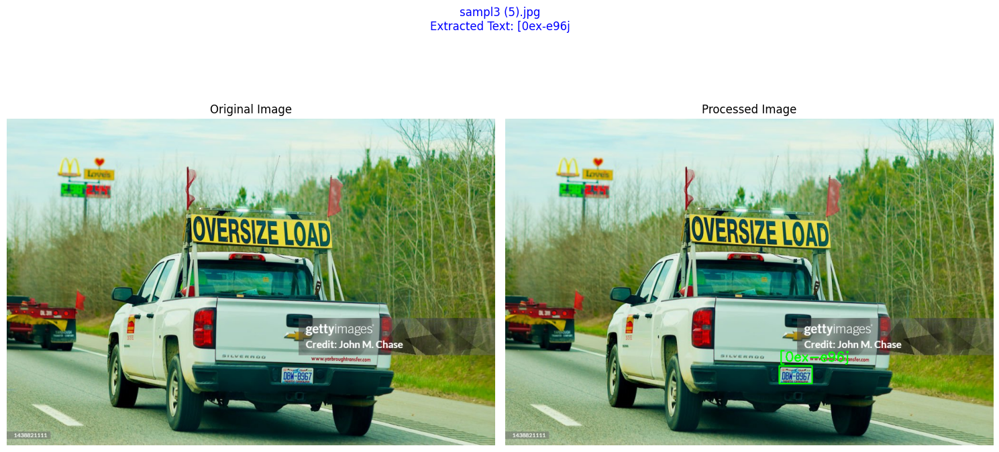

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (5)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (5)_detected_plates.txt

0: 448x640 1 License_Plate, 235.4ms
Speed: 4.4ms preprocess, 235.4ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


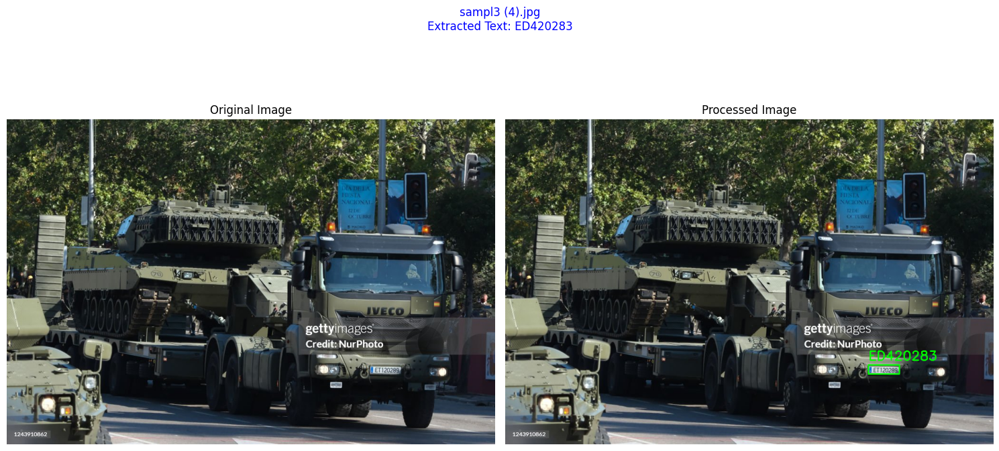

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (4)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (4)_detected_plates.txt

0: 384x640 2 License_Plates, 194.7ms
Speed: 3.8ms preprocess, 194.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


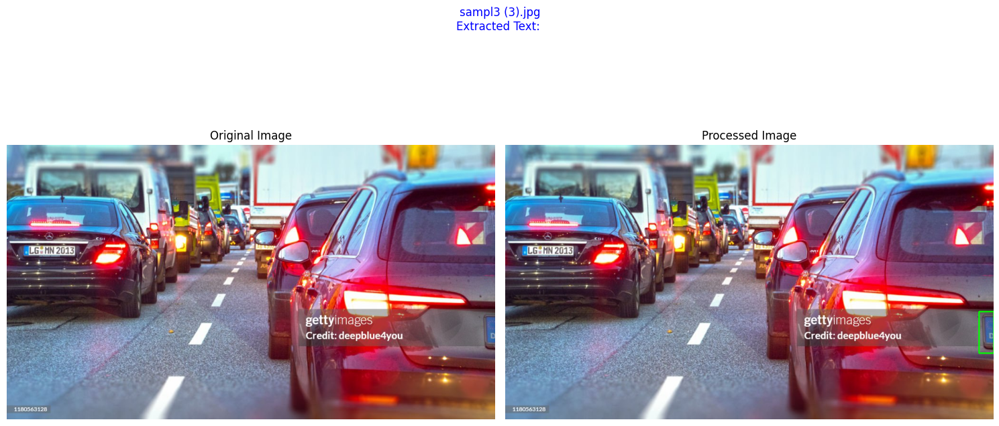

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (3)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (3)_detected_plates.txt

0: 384x640 1 License_Plate, 193.3ms
Speed: 4.1ms preprocess, 193.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


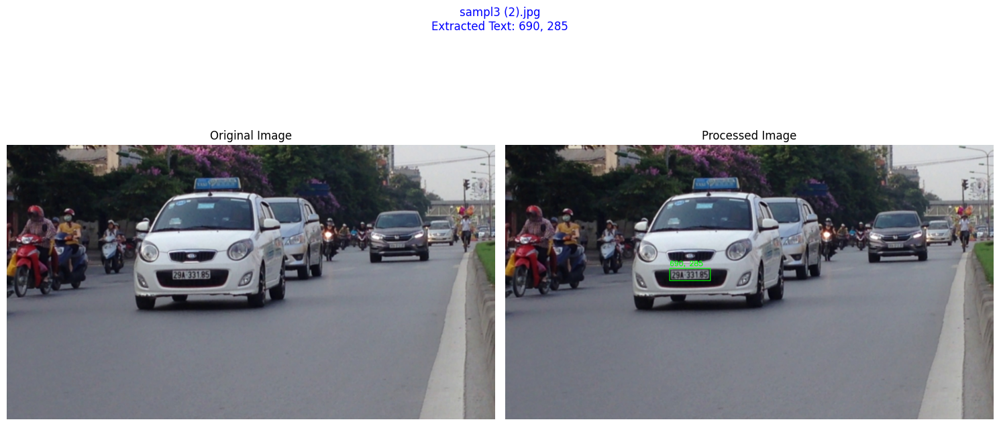

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (2)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (2)_detected_plates.txt

0: 448x640 4 License_Plates, 220.4ms
Speed: 4.8ms preprocess, 220.4ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


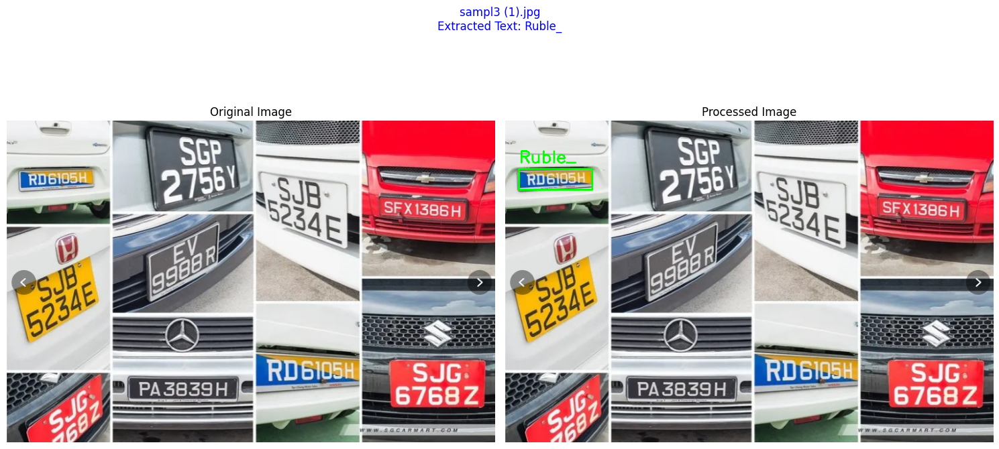

Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (1)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (1)_detected_plates.txt


In [ ]:

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'])

# Function to detect license plates and extract text
def detect_and_extract_text(image_path):
    if os.path.isfile(image_path):
        # Process a single image
        processed_image, extracted_text = process_single_image(image_path)
        if processed_image is not None:
            save_results(image_path, processed_image, extracted_text)
    elif os.path.isdir(image_path):
        # Process all images in a directory
        for filename in os.listdir(image_path):
            if filename.lower().endswith((".jpg", ".jpeg", ".png")):
                image_file_path = os.path.join(image_path, filename)
                processed_image, extracted_text = process_single_image(image_file_path)
                if processed_image is not None:
                    save_results(image_file_path, processed_image, extracted_text)
    else:
        print(f"Error: Invalid path '{image_path}'")

# Helper function to process a single image
def process_single_image(image_path):
    try:
        # Load image from URL or local path
        if image_path.startswith("http"):
            response = requests.get(image_path, stream=True)
            response.raise_for_status()
            image_data = response.content
            image = Image.open(io.BytesIO(image_data)).convert("RGB")
            original_image = np.array(image)[:, :, ::-1].copy()  # Convert RGB to BGR
        else:
            original_image = cv2.imread(image_path)

        if original_image is None:
            print(f"Error: Could not load image from '{image_path}'")
            return None, ""

        # Perform license plate detection and OCR
        results = model.predict(original_image, conf=0.5)
        detected_text = ""
        for r in results:
            boxes = r.boxes
            for box in boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])

        # Add padding around the bounding box
        padding = 0
        x1 = max(0, x1 - padding)
        y1 = max(0, y1 - padding)
        x2 = min(original_image.shape[1], x2 + padding)
        y2 = min(original_image.shape[0], y2 + padding)
        crop_img = original_image[y1:y2, x1:x2]

        # Preprocess the image for better OCR results
        gray = cv2.cvtColor(crop_img, cv2.COLOR_BGR2GRAY)
        _, binary = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # Perform OCR with detailed output
        ocr_result = reader.readtext(binary, detail=1)

        # Extract and concatenate all detected text

        detected_text = ""
        for _, text, _ in ocr_result:
            detected_text += text + "\n"

        # Draw bounding box and text on the processed image
        cv2.rectangle(original_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(original_image, detected_text.strip(), (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)
        return original_image, detected_text
    except Exception as e:
        print(f"Error processing image '{image_path}': {e}")
        return None, ""

# Helper function to save results
def save_results(image_path, processed_image, extracted_text):
    output_dir = "/content/drive/MyDrive/Detection_License_Plate_model/detected_results"
    os.makedirs(output_dir, exist_ok=True)
    filename = os.path.basename(image_path)
    processed_image_path = os.path.join(output_dir, f"{filename[:-4]}_processed.jpg")
    text_file_path = os.path.join(output_dir, f"{filename[:-4]}_detected_plates.txt")

    # Save processed image
    cv2.imwrite(processed_image_path, processed_image)

    # Save extracted text
    with open(text_file_path, "w") as f:
        f.write(extracted_text)

    print(f"Processed image saved to: {processed_image_path}")
    print(f"Detected text saved to: {text_file_path}")

# Example usage
image_path = "/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train"  # Update path as needed
detect_and_extract_text(image_path)

# ==============================================

def display_results(original_image, processed_image, extracted_text, title=""):
    """
    Display original image, processed image, and extracted text side-by-side.
    """
    # Convert BGR to RGB for display
    original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    processed_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)

    # Create a figure with two subplots
    plt.figure(figsize=(15, 8))

    # Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_image_rgb)
    plt.axis("off")
    plt.title("Original Image")

    # Show processed image
    plt.subplot(1, 2, 2)
    plt.imshow(processed_image_rgb)
    plt.axis("off")
    plt.title("Processed Image")

    # Display extracted text below the images
    plt.suptitle(f"{title}\nExtracted Text: {extracted_text.strip()}", fontsize=12, color='blue')
    plt.tight_layout()
    plt.show()

# Modify the detect_and_extract_text function to include visualization
def detect_and_extract_text_with_display(image_path):
    if os.path.isfile(image_path):
        processed_image, extracted_text = process_single_image(image_path)
        if processed_image is not None:
            original_image = cv2.imread(image_path)  # Load the original image
            display_results(original_image, processed_image, extracted_text, title=os.path.basename(image_path))
            save_results(image_path, processed_image, extracted_text)

    elif os.path.isdir(image_path):
        for filename in os.listdir(image_path):
            if filename.lower().endswith((".jpg", ".jpeg", ".png")):
                image_file_path = os.path.join(image_path, filename)
                processed_image, extracted_text = process_single_image(image_file_path)
                if processed_image is not None:
                    original_image = cv2.imread(image_file_path)  # Load the original image
                    display_results(original_image, processed_image, extracted_text, title=filename)
                    save_results(image_file_path, processed_image, extracted_text)
    else:
        print(f"Error: Invalid path '{image_path}'")

# Example usage
image_path = "/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train"  # Update path as needed
detect_and_extract_text_with_display(image_path)



0: 320x640 2 License_Plates, 116.7ms
Speed: 3.7ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 640)
Bounding Box 1: x1=2481, y1=472, x2=2773, y2=643
Bounding Box 2: x1=287, y1=427, x2=608, y2=626
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_detected_plates.txt

0: 448x640 1 License_Plate, 150.0ms
Speed: 3.4ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=207, y1=364, x2=440, y2=420
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_detected_plates.txt

0: 640x448 1 License_Plate, 163.1ms
Speed: 4.9ms preprocess, 163.1ms inference, 1.0ms pos

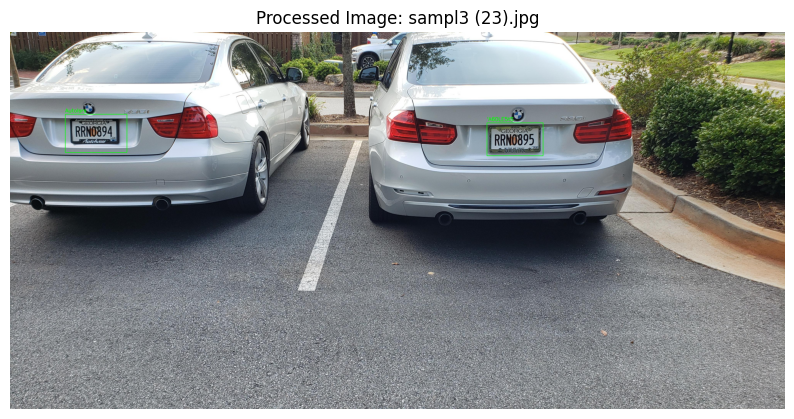


Processing file: sampl3 (22).jpg

0: 448x640 1 License_Plate, 244.3ms
Speed: 2.5ms preprocess, 244.3ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=207, y1=364, x2=440, y2=420
Extracted Text:
Plate_Extraction~1: 4626 KEX



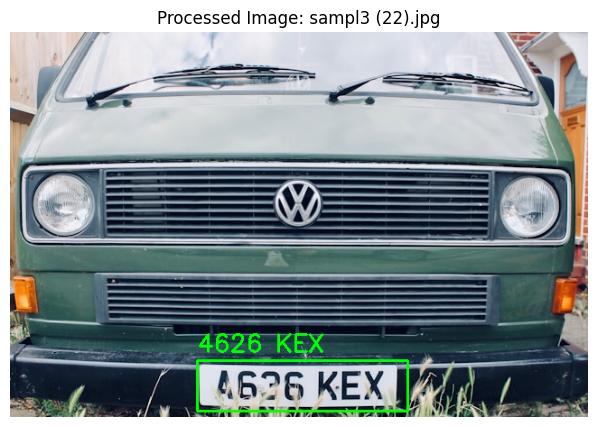


Processing file: sampl3 (21).jpg

0: 640x448 1 License_Plate, 269.2ms
Speed: 5.0ms preprocess, 269.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=157, y1=748, x2=287, y2=824
Extracted Text:
Plate_Extraction~1: RIzDN
Plate_Extraction~1: [cxh 5oz |
Plate_Extraction~1: INDCAnYON sto0



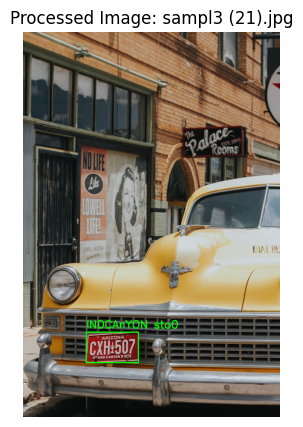


Processing file: sampl3 (20).jpg

0: 640x448 1 License_Plate, 271.5ms
Speed: 6.8ms preprocess, 271.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=351, y1=630, x2=591, y2=742
Extracted Text:
Plate_Extraction~1: NEW YORK
Plate_Extraction~1: HJG-5419
Plate_Extraction~1: WpiKI
Plate_Extraction~1: M



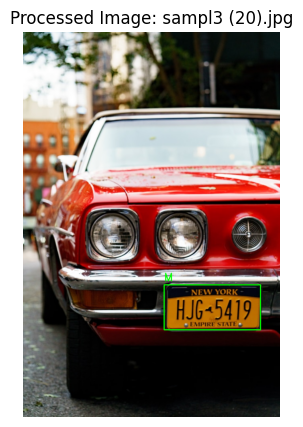


Processing file: sampl3 (19).jpg

0: 640x448 2 License_Plates, 276.1ms
Speed: 5.1ms preprocess, 276.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=368, y1=558, x2=491, y2=597
Bounding Box 2: x1=4, y1=467, x2=44, y2=479
Extracted Text:
Plate_Extraction~1: FB592-NF&



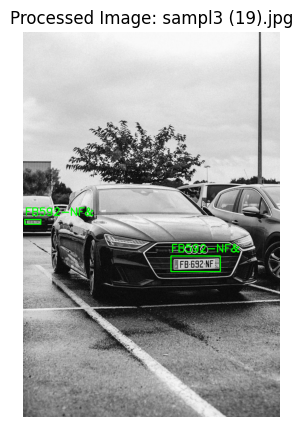


Processing file: sampl3 (18).jpg

0: 640x448 1 License_Plate, 248.0ms
Speed: 4.6ms preprocess, 248.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=10, y1=544, x2=221, y2=613
Extracted Text:
Plate_Extraction~1: 03183 KND



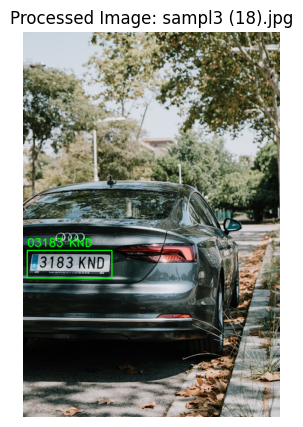


Processing file: sampl3 (17).jpg

0: 448x640 2 License_Plates, 182.2ms
Speed: 4.6ms preprocess, 182.2ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=716, y1=279, x2=848, y2=313
Bounding Box 2: x1=154, y1=425, x2=277, y2=457
Extracted Text:
Plate_Extraction~1: NOT 2B
Plate_Extraction~2: 2BE



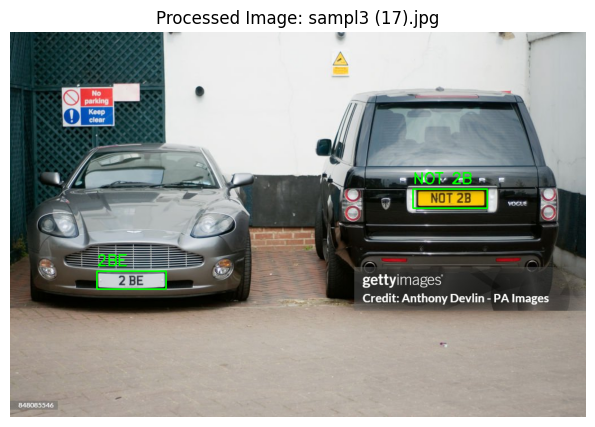


Processing file: sampl3 (16).jpg

0: 640x640 2 License_Plates, 256.7ms
Speed: 7.2ms preprocess, 256.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Bounding Box 1: x1=577, y1=537, x2=757, y2=578
Bounding Box 2: x1=263, y1=443, x2=382, y2=478
Extracted Text:
Plate_Extraction~1: W945V
Plate_Extraction~2: N?oipuv



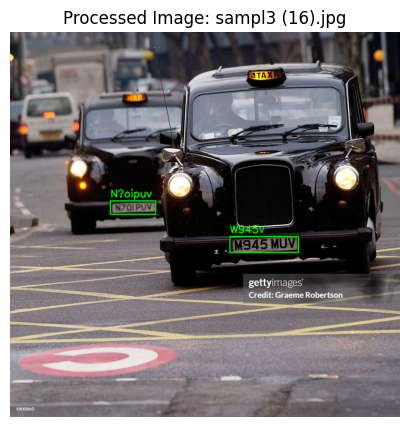


Processing file: sampl3 (15).jpg

0: 352x640 2 License_Plates, 181.6ms
Speed: 3.7ms preprocess, 181.6ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)
Bounding Box 1: x1=588, y1=282, x2=770, y2=336
Bounding Box 2: x1=1460, y1=194, x2=1585, y2=236
Extracted Text:
Plate_Extraction~1: 54 DMB 1



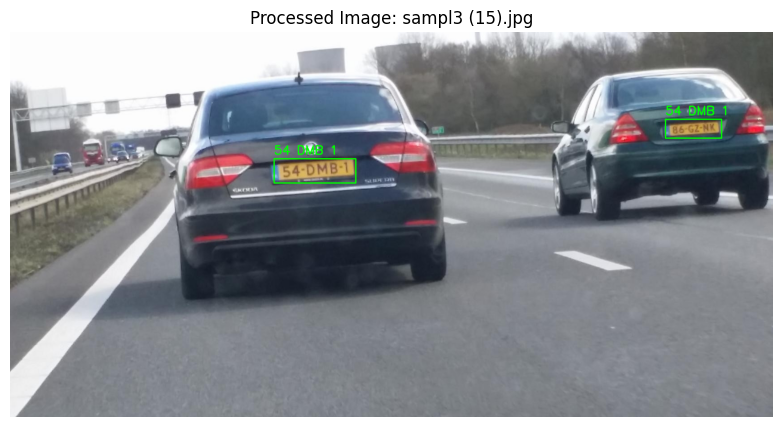


Processing file: sampl3 (14).jpg

0: 448x640 1 License_Plate, 216.9ms
Speed: 3.8ms preprocess, 216.9ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=315, y1=198, x2=451, y2=260
Extracted Text:
Plate_Extraction~1: RUwA
Plate_Extraction~1: in
Plate_Extraction~1: 2,8035
Plate_Extraction~1: Juj



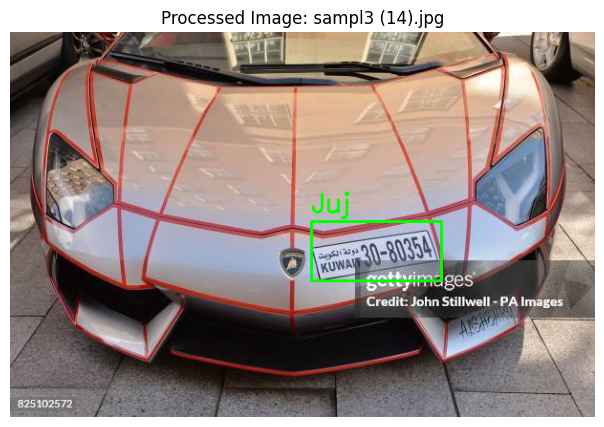


Processing file: sampl3 (13).jpg

0: 448x640 1 License_Plate, 216.0ms
Speed: 4.4ms preprocess, 216.0ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=666, y1=265, x2=793, y2=343
Extracted Text:
Plate_Extraction~1: Itku
Plate_Extraction~1: BLTS:0L5L



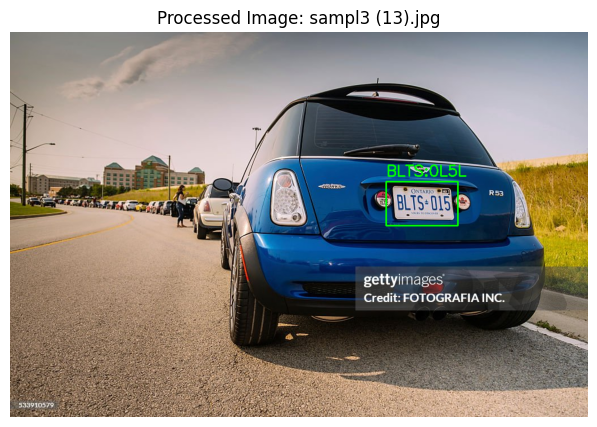


Processing file: sampl3 (12).jpg

0: 640x512 1 License_Plate, 241.2ms
Speed: 5.5ms preprocess, 241.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 512)
Bounding Box 1: x1=296, y1=549, x2=447, y2=664
Extracted Text:
Plate_Extraction~1: ICs
Plate_Extraction~1: 5
Plate_Extraction~1: 928LL



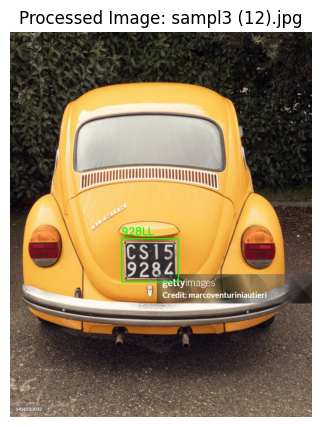


Processing file: sampl3 (11).jpg

0: 512x640 1 License_Plate, 239.9ms
Speed: 5.3ms preprocess, 239.9ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)
Bounding Box 1: x1=417, y1=477, x2=609, y2=585
Extracted Text:
Plate_Extraction~1: @0
Plate_Extraction~1: 66
Plate_Extraction~1: Te8iNa
Plate_Extraction~1: 37
Plate_Extraction~1: 'ArizonFr 
Plate_Extraction~1: ROUTE



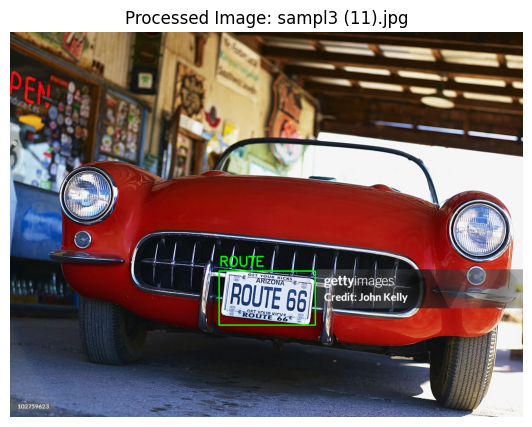


Processing file: sampl3 (10).jpg

0: 448x640 2 License_Plates, 235.4ms
Speed: 9.5ms preprocess, 235.4ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=112, y1=295, x2=248, y2=362
Bounding Box 2: x1=655, y1=305, x2=793, y2=377
Extracted Text:
Plate_Extraction~1: NZL =5gi 
Plate_Extraction~2: 0uJ1672



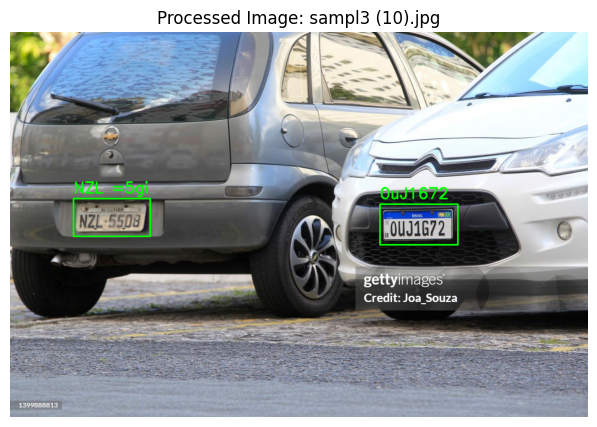


Processing file: sampl3 (9).jpg

0: 448x640 2 License_Plates, 232.1ms
Speed: 4.4ms preprocess, 232.1ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=208, y1=324, x2=336, y2=372
Bounding Box 2: x1=770, y1=312, x2=891, y2=359
Extracted Text:
Plate_Extraction~1: 0z5J50
Plate_Extraction~2: PLYH76



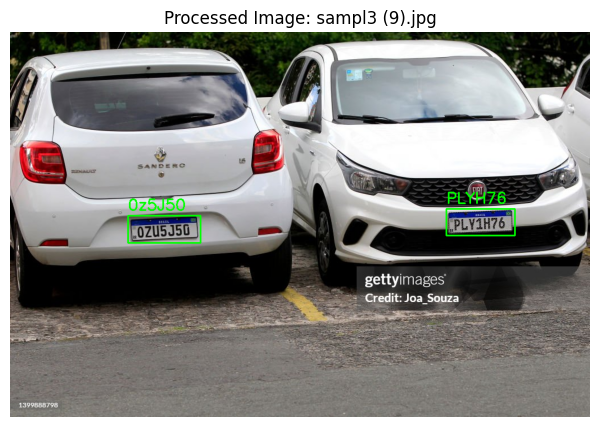


Processing file: sampl3 (8).jpg

0: 448x640 2 License_Plates, 216.2ms
Speed: 4.3ms preprocess, 216.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=36, y1=548, x2=132, y2=603
Bounding Box 2: x1=820, y1=637, x2=953, y2=683
Extracted Text:
Plate_Extraction~1: 0z2
Plate_Extraction~1: 6089
Plate_Extraction~2: 3451
Plate_Extraction~2: 4c7



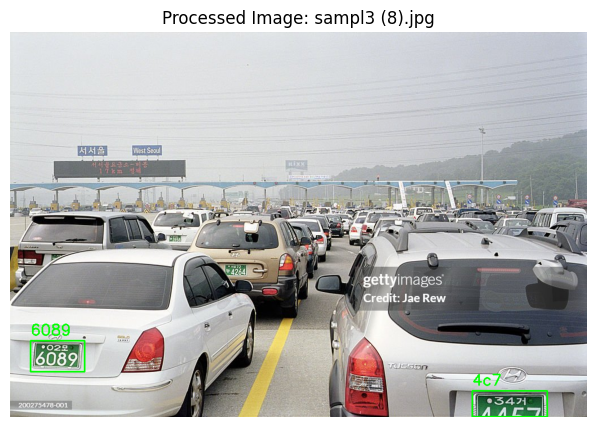


Processing file: sampl3 (7).jpg

0: 448x640 1 License_Plate, 247.2ms
Speed: 5.0ms preprocess, 247.2ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=220, y1=510, x2=375, y2=551
Extracted Text:
Plate_Extraction~1: 1813 JKC



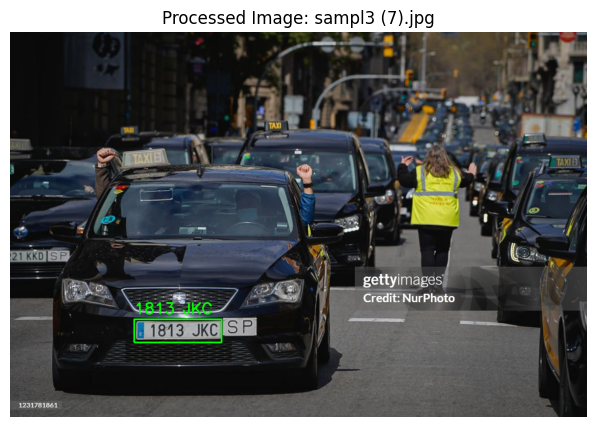


Processing file: sampl3 (6).jpg

0: 448x640 1 License_Plate, 311.8ms
Speed: 4.5ms preprocess, 311.8ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=271, y1=458, x2=367, y2=529
Extracted Text:
Plate_Extraction~1: Idoc: 366



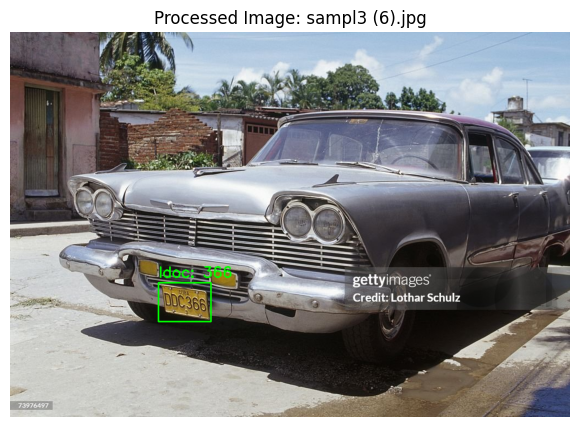


Processing file: sampl3 (5).jpg

0: 448x640 1 License_Plate, 309.9ms
Speed: 4.3ms preprocess, 309.9ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=574, y1=518, x2=643, y2=555
Extracted Text:
Plate_Extraction~1: [0ex-e96j



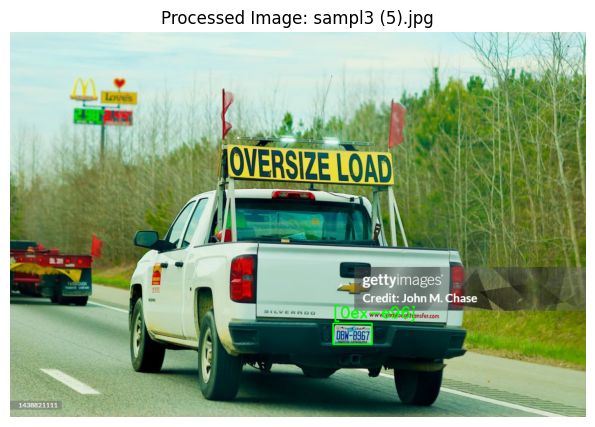


Processing file: sampl3 (4).jpg

0: 448x640 1 License_Plate, 260.2ms
Speed: 4.6ms preprocess, 260.2ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=761, y1=515, x2=826, y2=534
Extracted Text:
Plate_Extraction~1: ED420283



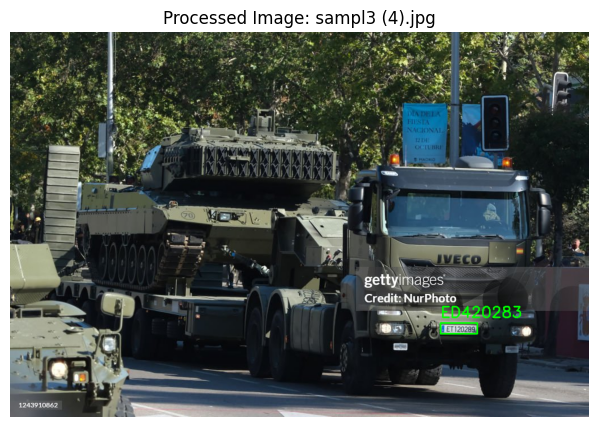


Processing file: sampl3 (3).jpg

0: 384x640 2 License_Plates, 207.4ms
Speed: 4.1ms preprocess, 207.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Bounding Box 1: x1=35, y1=208, x2=146, y2=237
Bounding Box 2: x1=993, y1=350, x2=1024, y2=437
Extracted Text:
Plate_Extraction~1: @GElN2o13



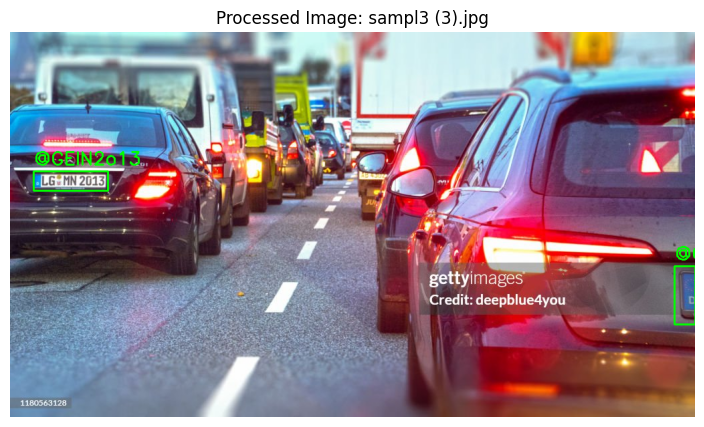


Processing file: sampl3 (2).jpg

0: 384x640 1 License_Plate, 235.3ms
Speed: 7.0ms preprocess, 235.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Bounding Box 1: x1=646, y1=487, x2=806, y2=535
Extracted Text:
Plate_Extraction~1: 690, 285



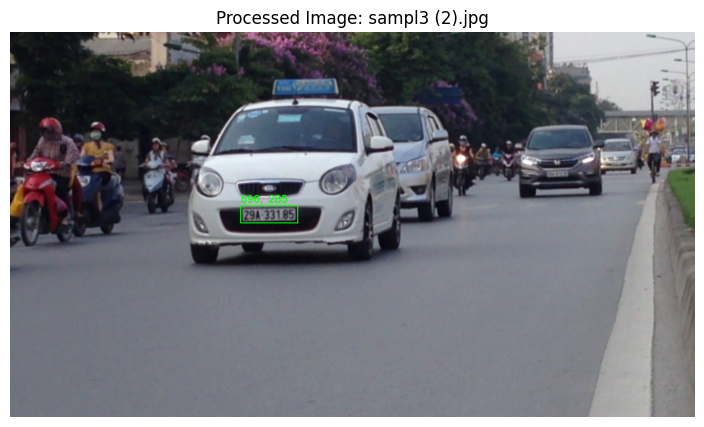


Processing file: sampl3 (1).jpg

0: 448x640 4 License_Plates, 299.6ms
Speed: 4.6ms preprocess, 299.6ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=618, y1=383, x2=779, y2=472
Bounding Box 2: x1=194, y1=413, x2=377, y2=458
Bounding Box 3: x1=619, y1=124, x2=750, y2=164
Bounding Box 4: x1=22, y1=78, x2=141, y2=112
Extracted Text:
Plate_Extraction~1: SJG:
Plate_Extraction~1: 6768z
Plate_Extraction~2: PA3839H
Plate_Extraction~3: SFX1386H
Plate_Extraction~4: Ruble_



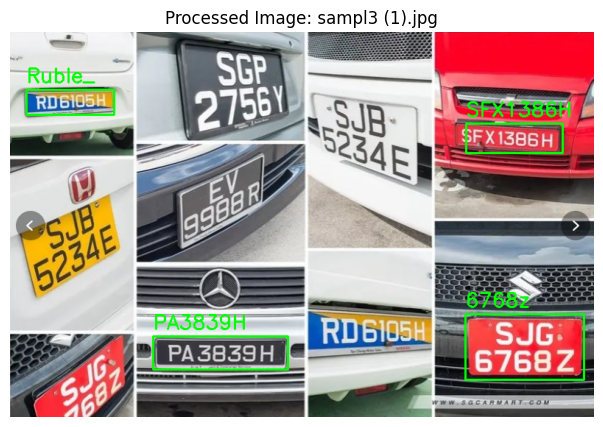

In [ ]:
# BEST ONE YET NEED TO FURTHER ADD PROVISION FOR - clean text / grayscale / Basic binary and adaptive thresholding / Denoise / Contrast

#!pip install easyocr

# Import required libraries
#import io
#import os
#import requests
#import numpy as np
#import cv2
#import easyocr
#from PIL import Image
#import matplotlib.pyplot as plt

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'])

# Function to detect license plates and extract text from a single image
def process_single_image(image_path):
    try:
        # Load image from URL or local path
        if image_path.startswith("http"):
            response = requests.get(image_path, stream=True)
            response.raise_for_status()
            image_data = response.content
            image = Image.open(io.BytesIO(image_data)).convert("RGB")
            original_image = np.array(image)[:, :, ::-1].copy()  # Convert RGB to BGR
        else:
            original_image = cv2.imread(image_path)

        if original_image is None:
            print(f"Error: Could not load image from '{image_path}'")
            return None, ""

        # Using trained model to perform license plate detection
        results = model.predict(original_image, conf=0.5)
        detected_text = ""

        for r in results:
            boxes = r.boxes
            for i, box in enumerate(boxes):
                x1, y1, x2, y2 = map(int, box.xyxy[0])

                # Debugging bounding box coordinates
                print(f"Bounding Box {i+1}: x1={x1}, y1={y1}, x2={x2}, y2={y2}")

                # Add padding around the bounding box
                padding = 0
                x1 = max(0, x1 - padding)
                y1 = max(0, y1 - padding)
                x2 = min(original_image.shape[1], x2 + padding)
                y2 = min(original_image.shape[0], y2 + padding)
                crop_img = original_image[y1:y2, x1:x2]

                # Preprocess the image for better OCR results
                gray = cv2.cvtColor(crop_img, cv2.COLOR_BGR2GRAY)
                _, binary = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

                # Perform OCR
                ocr_result = reader.readtext(binary, detail=1)
                for _, text, _ in ocr_result:
                    detected_text += f"Plate_Extraction~{i+1}: {text}\n" # Extraction Layers

                # Draw bounding box and text on the processed image
                cv2.rectangle(original_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(original_image, text.strip(), (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

        return original_image, detected_text
    except Exception as e:
        print(f"Error processing image '{image_path}': {e}")
        return None, ""

# Function to save processed results
def save_results(image_path, processed_image, extracted_text):
    output_dir = "/content/drive/MyDrive/Detection_License_Plate_model/detected_results"
    os.makedirs(output_dir, exist_ok=True)
    filename = os.path.basename(image_path)
    processed_image_path = os.path.join(output_dir, f"{filename[:-4]}_processed.jpg")
    text_file_path = os.path.join(output_dir, f"{filename[:-4]}_detected_plates.txt")

    # Save processed image
    cv2.imwrite(processed_image_path, processed_image)

    # Save extracted text
    with open(text_file_path, "w") as f:
        f.write(extracted_text)

    print(f"Processed image saved to: {processed_image_path}")
    print(f"Detected text saved to: {text_file_path}")

# Function to process a single image or all images in a folder
def detect_and_extract_text(image_path):
    if os.path.isfile(image_path):
        # Process a single image
        processed_image, extracted_text = process_single_image(image_path)
        if processed_image is not None:
            save_results(image_path, processed_image, extracted_text)
    elif os.path.isdir(image_path):
        # Process all images in a directory
        for filename in os.listdir(image_path):
            if filename.lower().endswith((".jpg", ".jpeg", ".png")):
                image_file_path = os.path.join(image_path, filename)
                processed_image, extracted_text = process_single_image(image_file_path)
                if processed_image is not None:
                    save_results(image_file_path, processed_image, extracted_text)
    else:
        print(f"Error: Invalid path '{image_path}'")

# Function to test multiple images with debugging and display
def test_images_in_folder(folder_path):
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist")
        return

    for filename in os.listdir(folder_path):
        if filename.lower().endswith((".jpg", ".jpeg", ".png")):
            image_file_path = os.path.join(folder_path, filename)
            print(f"\nProcessing file: {filename}")
            processed_image, extracted_text = process_single_image(image_file_path)

            # Display bounding boxes, extracted text, and cropped images for debugging
            if processed_image is not None:
                print(f"Extracted Text:\n{extracted_text}")
                plt.figure(figsize=(10, 5))
                plt.imshow(cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB))
                plt.title(f"Processed Image: {filename}")
                plt.axis("off")
                plt.show()

# Example usage for single image or folder
image_path = "/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train"  # Update path as needed
detect_and_extract_text(image_path)

# Test folder images with debugging
image_path = "/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train"  # Update path as needed
test_images_in_folder(image_path)



0: 320x640 2 License_Plates, 138.9ms
Speed: 5.1ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 640)
Bounding Box 1: x1=2481, y1=472, x2=2773, y2=643
Bounding Box 2: x1=287, y1=427, x2=608, y2=626
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (23)_detected_plates.txt

0: 448x640 1 License_Plate, 150.3ms
Speed: 3.6ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=207, y1=364, x2=440, y2=420
Processed image saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_processed.jpg
Detected text saved to: /content/drive/MyDrive/Detection_License_Plate_model/detected_results/sampl3 (22)_detected_plates.txt

0: 640x448 1 License_Plate, 151.2ms
Speed: 6.9ms preprocess, 151.2ms inference, 0.9ms pos

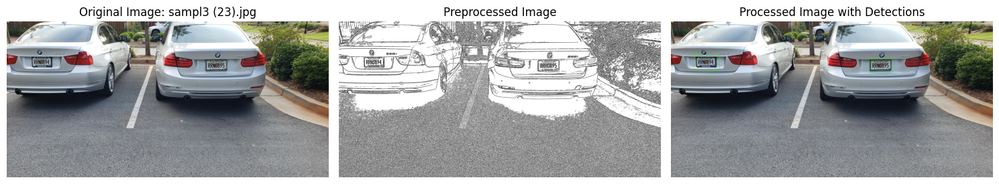

Extracted Text:
Plate_Extraction~1: IRRNO895
Plate_Extraction~1: RGI
Plate_Extraction~2: LEOM
Plate_Extraction~2: RRNO894


Processing file: sampl3 (22).jpg

0: 448x640 1 License_Plate, 147.3ms
Speed: 2.3ms preprocess, 147.3ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=207, y1=364, x2=440, y2=420


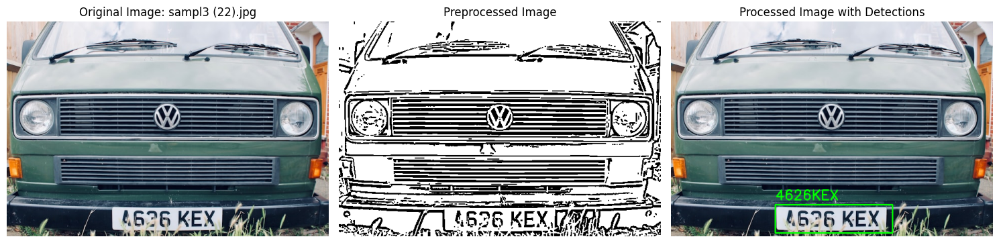

Extracted Text:
Plate_Extraction~1: 4626KEX


Processing file: sampl3 (21).jpg

0: 640x448 1 License_Plate, 163.2ms
Speed: 6.0ms preprocess, 163.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=157, y1=748, x2=287, y2=824


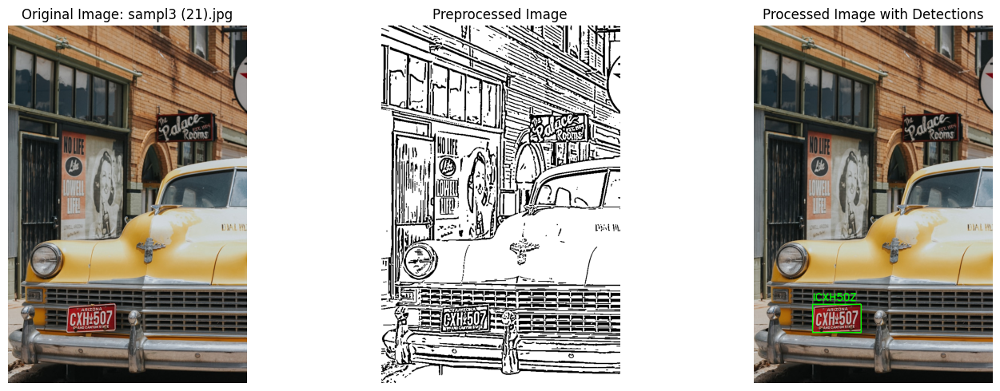

Extracted Text:
Plate_Extraction~1: ICXH50Z


Processing file: sampl3 (20).jpg

0: 640x448 1 License_Plate, 172.9ms
Speed: 4.8ms preprocess, 172.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=351, y1=630, x2=591, y2=742


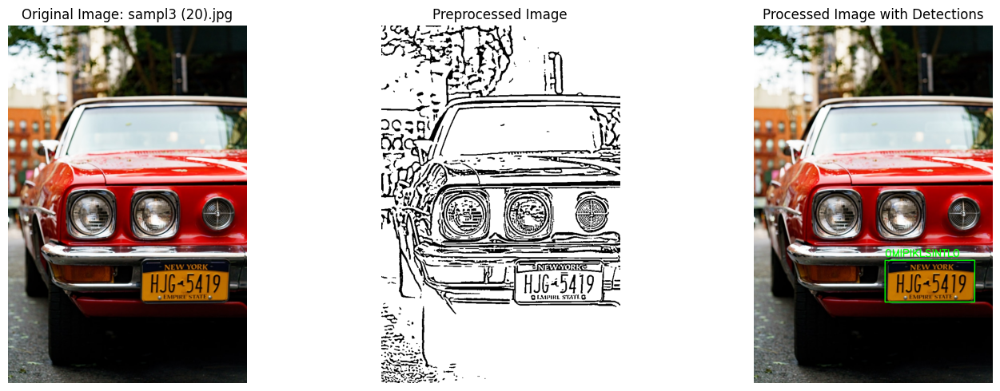

Extracted Text:
Plate_Extraction~1: NHYQRRE
Plate_Extraction~1: HJG5419


Processing file: sampl3 (19).jpg

0: 640x448 2 License_Plates, 158.6ms
Speed: 5.4ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=368, y1=558, x2=491, y2=597
Bounding Box 2: x1=4, y1=467, x2=44, y2=479


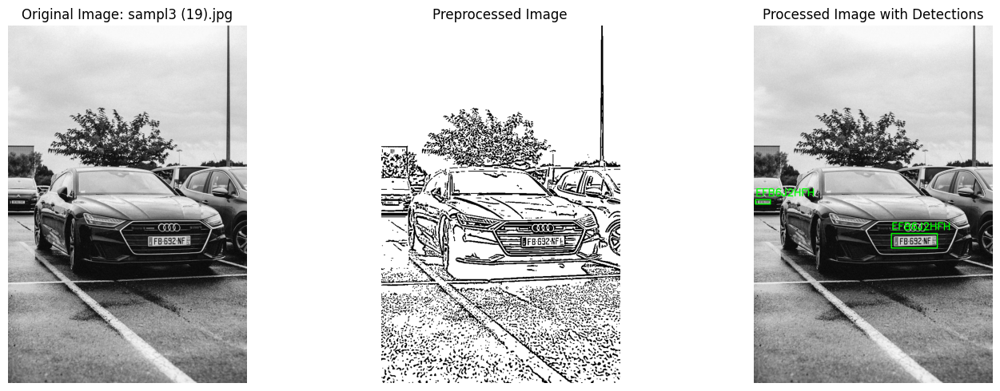

Extracted Text:


Processing file: sampl3 (18).jpg

0: 640x448 1 License_Plate, 264.9ms
Speed: 4.7ms preprocess, 264.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)
Bounding Box 1: x1=10, y1=544, x2=221, y2=613


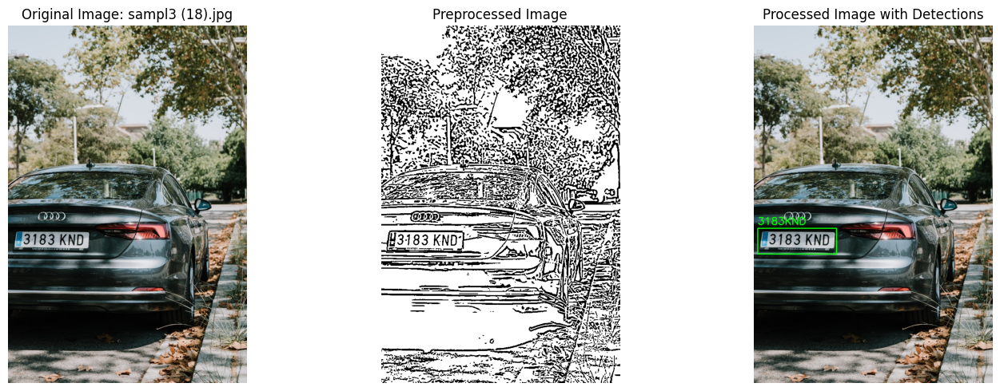

Extracted Text:
Plate_Extraction~1: 3183KND


Processing file: sampl3 (17).jpg

0: 448x640 2 License_Plates, 246.7ms
Speed: 5.6ms preprocess, 246.7ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=716, y1=279, x2=848, y2=313
Bounding Box 2: x1=154, y1=425, x2=277, y2=457


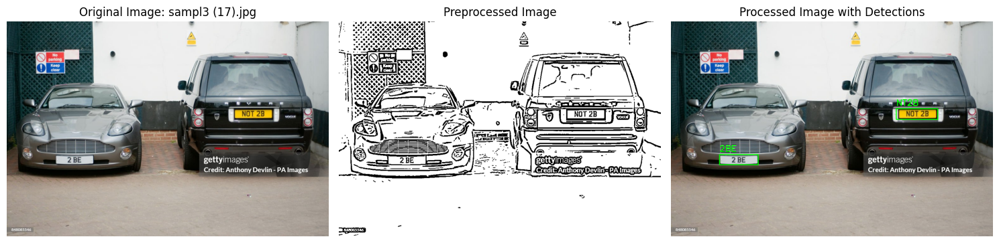

Extracted Text:
Plate_Extraction~1: NT2B
Plate_Extraction~2: 2BE


Processing file: sampl3 (16).jpg

0: 640x640 2 License_Plates, 242.0ms
Speed: 8.3ms preprocess, 242.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Bounding Box 1: x1=577, y1=537, x2=757, y2=578
Bounding Box 2: x1=263, y1=443, x2=382, y2=478


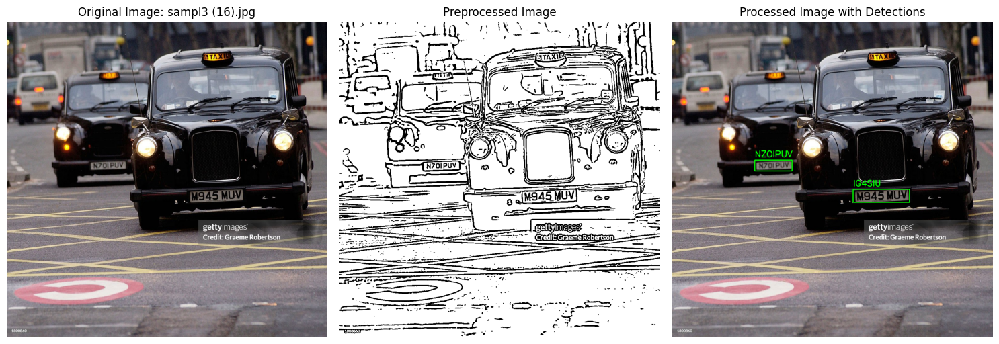

Extracted Text:
Plate_Extraction~2: NZOIPUV


Processing file: sampl3 (15).jpg

0: 352x640 2 License_Plates, 183.4ms
Speed: 3.9ms preprocess, 183.4ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)
Bounding Box 1: x1=588, y1=282, x2=770, y2=336
Bounding Box 2: x1=1460, y1=194, x2=1585, y2=236


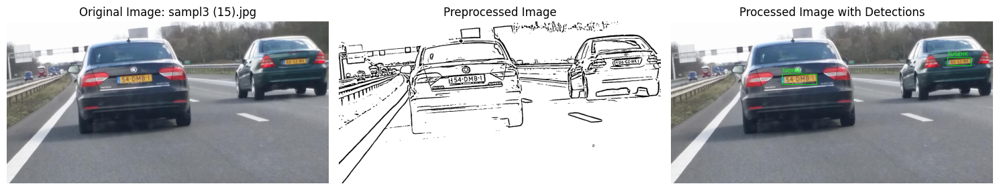

Extracted Text:


Processing file: sampl3 (14).jpg

0: 448x640 1 License_Plate, 204.2ms
Speed: 5.9ms preprocess, 204.2ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=315, y1=198, x2=451, y2=260


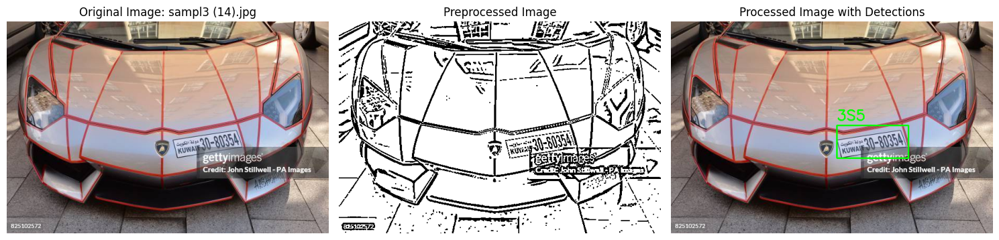

Extracted Text:


Processing file: sampl3 (13).jpg

0: 448x640 1 License_Plate, 278.2ms
Speed: 4.6ms preprocess, 278.2ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=666, y1=265, x2=793, y2=343


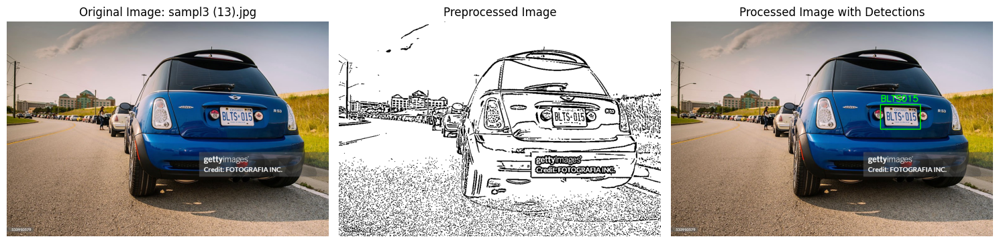

Extracted Text:
Plate_Extraction~1: BLTS015


Processing file: sampl3 (12).jpg

0: 640x512 1 License_Plate, 227.3ms
Speed: 6.9ms preprocess, 227.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 512)
Bounding Box 1: x1=296, y1=549, x2=447, y2=664


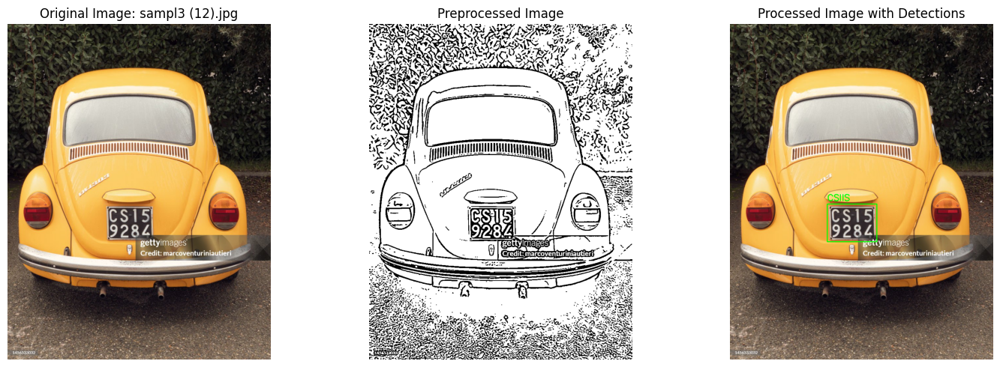

Extracted Text:
Plate_Extraction~1: CSIIS


Processing file: sampl3 (11).jpg

0: 512x640 1 License_Plate, 237.4ms
Speed: 7.4ms preprocess, 237.4ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)
Bounding Box 1: x1=417, y1=477, x2=609, y2=585


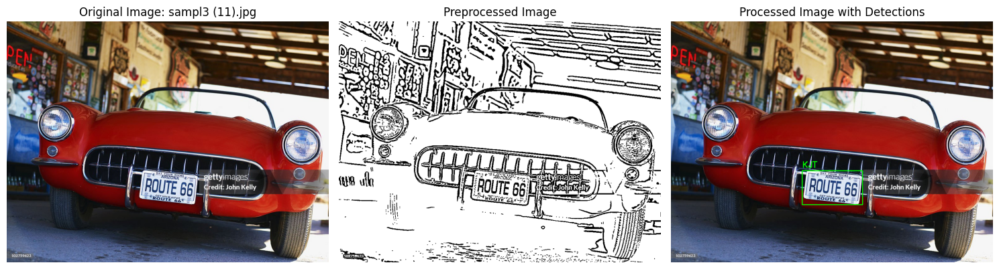

Extracted Text:
Plate_Extraction~1: 661
Plate_Extraction~1: ROUZE


Processing file: sampl3 (10).jpg

0: 448x640 2 License_Plates, 204.0ms
Speed: 8.1ms preprocess, 204.0ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=112, y1=295, x2=248, y2=362
Bounding Box 2: x1=655, y1=305, x2=793, y2=377


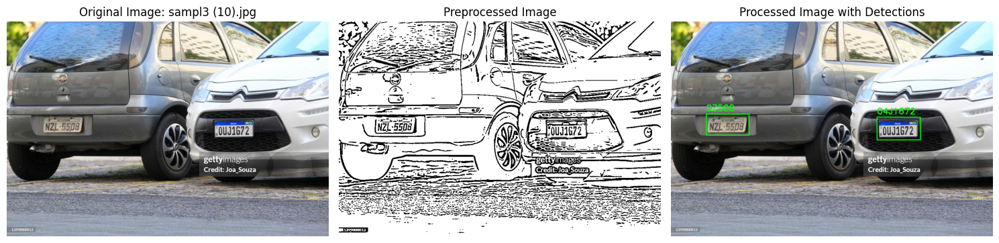

Extracted Text:
Plate_Extraction~2: 04J1672


Processing file: sampl3 (9).jpg

0: 448x640 2 License_Plates, 189.2ms
Speed: 5.8ms preprocess, 189.2ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=208, y1=324, x2=336, y2=372
Bounding Box 2: x1=770, y1=312, x2=891, y2=359


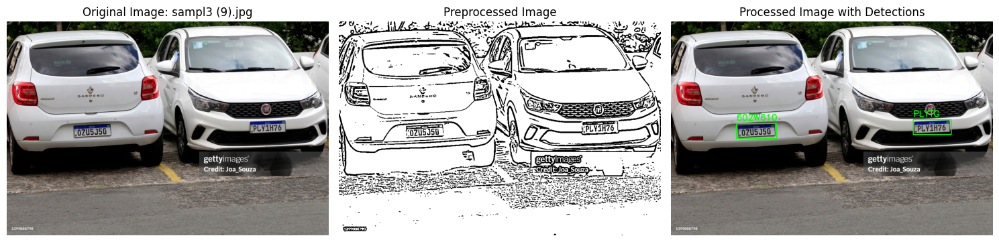

Extracted Text:


Processing file: sampl3 (8).jpg

0: 448x640 2 License_Plates, 241.5ms
Speed: 5.0ms preprocess, 241.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=36, y1=548, x2=132, y2=603
Error processing image '/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train/sampl3 (8).jpg': local variable 'cleaned_text' referenced before assignment

Processing file: sampl3 (7).jpg

0: 448x640 1 License_Plate, 271.1ms
Speed: 4.4ms preprocess, 271.1ms inference, 3.5ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=220, y1=510, x2=375, y2=551


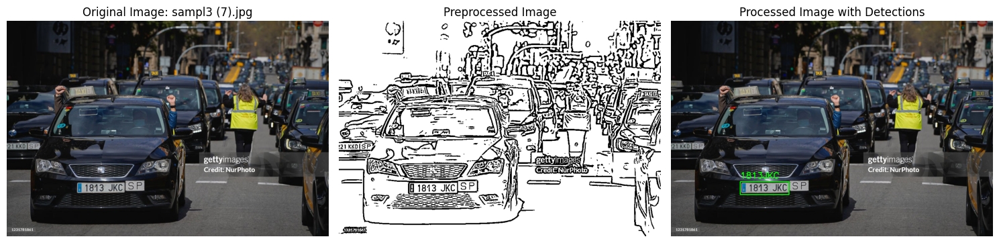

Extracted Text:
Plate_Extraction~1: 1813JKC


Processing file: sampl3 (6).jpg

0: 448x640 1 License_Plate, 201.4ms
Speed: 6.6ms preprocess, 201.4ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=271, y1=458, x2=367, y2=529


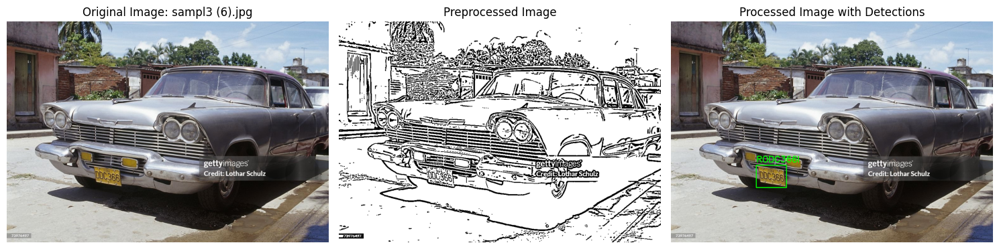

Extracted Text:


Processing file: sampl3 (5).jpg

0: 448x640 1 License_Plate, 228.9ms
Speed: 6.7ms preprocess, 228.9ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=574, y1=518, x2=643, y2=555


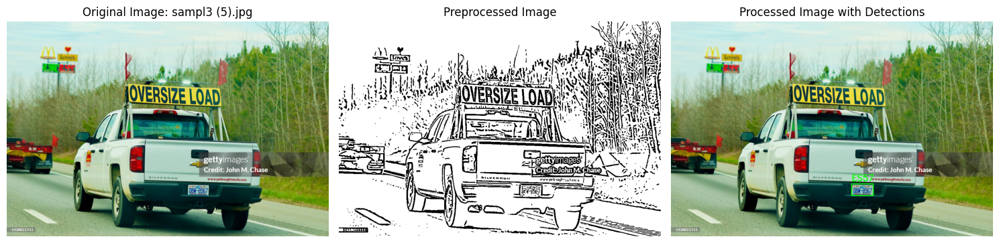

Extracted Text:


Processing file: sampl3 (4).jpg

0: 448x640 1 License_Plate, 223.5ms
Speed: 5.5ms preprocess, 223.5ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=761, y1=515, x2=826, y2=534


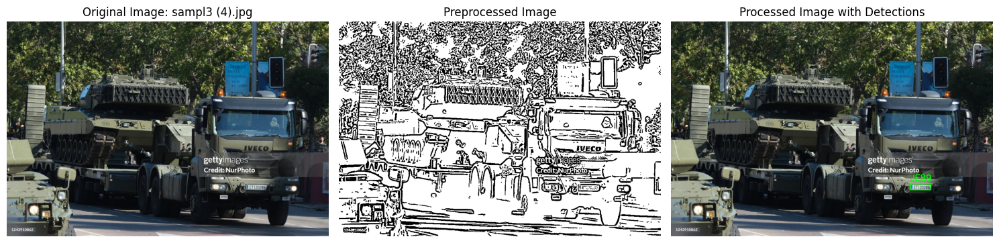

Extracted Text:


Processing file: sampl3 (3).jpg

0: 384x640 2 License_Plates, 213.9ms
Speed: 4.9ms preprocess, 213.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Bounding Box 1: x1=35, y1=208, x2=146, y2=237
Bounding Box 2: x1=993, y1=350, x2=1024, y2=437


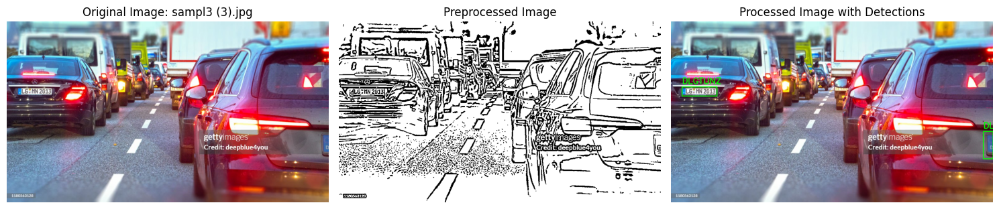

Extracted Text:


Processing file: sampl3 (2).jpg

0: 384x640 1 License_Plate, 213.7ms
Speed: 4.7ms preprocess, 213.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Bounding Box 1: x1=646, y1=487, x2=806, y2=535


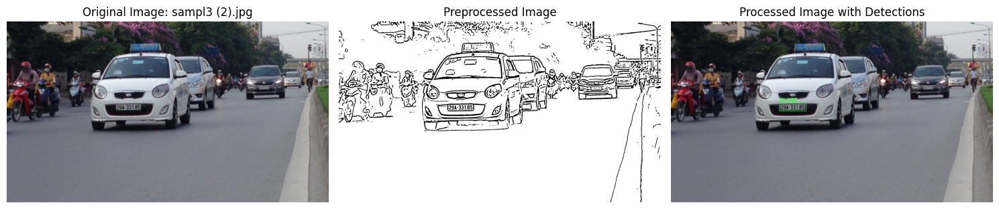

Extracted Text:
Plate_Extraction~1: 293185


Processing file: sampl3 (1).jpg

0: 448x640 4 License_Plates, 229.3ms
Speed: 6.7ms preprocess, 229.3ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)
Bounding Box 1: x1=618, y1=383, x2=779, y2=472
Bounding Box 2: x1=194, y1=413, x2=377, y2=458
Bounding Box 3: x1=619, y1=124, x2=750, y2=164
Bounding Box 4: x1=22, y1=78, x2=141, y2=112


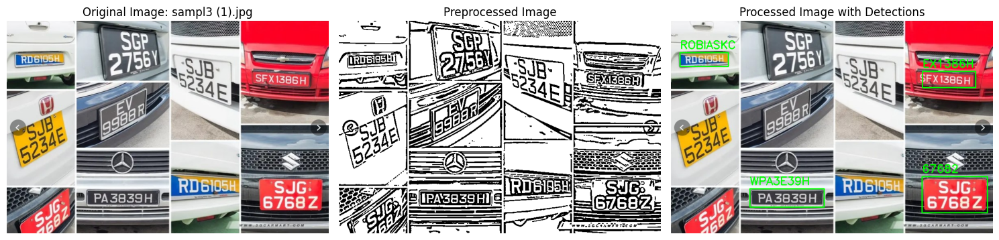

Extracted Text:
Plate_Extraction~1: SJC
Plate_Extraction~1: 67682
Plate_Extraction~3: EX1386H



In [ ]:
#revamp

# Initialize EasyOCR reader
reader = easyocr.Reader(['en'])

def preprocess_image(image):
    """
    Advanced image preprocessing for improved OCR results

    Args:
        image (numpy.ndarray): Input image

    Returns:
        numpy.ndarray: Preprocessed image
    """
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Noise reduction
    # 1. Non-local means denoising
    denoised = cv2.fastNlMeansDenoising(gray, None, 10, 7, 21)

    # 2. Adaptive thresholding (handles varying lighting conditions)
    adaptive_thresh = cv2.adaptiveThreshold(
        denoised,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY,
        11,
        2
    )

    # Contrast enhancement
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    contrast_enhanced = clahe.apply(adaptive_thresh)

    # Optional: Morphological operations to clean up the image
    kernel = np.ones((2,2), np.uint8)
    cleaned = cv2.morphologyEx(contrast_enhanced, cv2.MORPH_CLOSE, kernel)

    return cleaned

def clean_extracted_text(text):
    """
    Clean extracted text by removing non-alphanumeric characters
    and standardizing format

    Args:
        text (str): Raw extracted text

    Returns:
        str: Cleaned text
    """
    # Remove non-alphanumeric characters
    cleaned = re.sub(r'[^a-zA-Z0-9]', '', text)

    # Convert to uppercase
    cleaned = cleaned.upper()

    return cleaned

def process_single_image(image_path):
    try:
        # Load image from URL or local path
        if image_path.startswith("http"):
            response = requests.get(image_path, stream=True)
            response.raise_for_status()
            image_data = response.content
            image = Image.open(io.BytesIO(image_data)).convert("RGB")
            original_image = np.array(image)[:, :, ::-1].copy()  # Convert RGB to BGR
        else:
            original_image = cv2.imread(image_path)

        if original_image is None:
            print(f"Error: Could not load image from '{image_path}'")
            return None, ""

        # Using trained model to perform license plate detection
        results = model.predict(original_image, conf=0.5)
        detected_text = ""

        for r in results:
            boxes = r.boxes
            for i, box in enumerate(boxes):
                x1, y1, x2, y2 = map(int, box.xyxy[0])

                # Debugging bounding box coordinates
                print(f"Bounding Box {i+1}: x1={x1}, y1={y1}, x2={x2}, y2={y2}")

                # Add padding around the bounding box
                padding = 0
                x1 = max(0, x1 - padding)
                y1 = max(0, y1 - padding)
                x2 = min(original_image.shape[1], x2 + padding)
                y2 = min(original_image.shape[0], y2 + padding)
                crop_img = original_image[y1:y2, x1:x2]

                # Preprocess the cropped image
                preprocessed_img = preprocess_image(crop_img)

                # Perform OCR
                ocr_result = reader.readtext(preprocessed_img, detail=1)

                for _, text, confidence in ocr_result:
                    # Clean and filter extracted text
                    cleaned_text = clean_extracted_text(text)

                    # Only add if text is not empty and meets minimum confidence
                    if cleaned_text and confidence > 0.35:
                        detected_text += f"Plate_Extraction~{i+1}: {cleaned_text}\n"

                # Draw bounding box and text on the processed image
                cv2.rectangle(original_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(original_image, cleaned_text.strip(), (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

        return original_image, detected_text
    except Exception as e:
        print(f"Error processing image '{image_path}': {e}")
        return None, ""

def save_results(image_path, processed_image, extracted_text):
    output_dir = "/content/drive/MyDrive/Detection_License_Plate_model/detected_results"
    os.makedirs(output_dir, exist_ok=True)
    filename = os.path.basename(image_path)
    processed_image_path = os.path.join(output_dir, f"{filename[:-4]}_processed.jpg")
    text_file_path = os.path.join(output_dir, f"{filename[:-4]}_detected_plates.txt")

    # Save processed image
    cv2.imwrite(processed_image_path, processed_image)

    # Save extracted text
    with open(text_file_path, "w") as f:
        f.write(extracted_text)

    print(f"Processed image saved to: {processed_image_path}")
    print(f"Detected text saved to: {text_file_path}")

def detect_and_extract_text(image_path):
    if os.path.isfile(image_path):
        # Process a single image
        processed_image, extracted_text = process_single_image(image_path)
        if processed_image is not None:
            save_results(image_path, processed_image, extracted_text)
    elif os.path.isdir(image_path):
        # Process all images in a directory
        for filename in os.listdir(image_path):
            if filename.lower().endswith((".jpg", ".jpeg", ".png")):
                image_file_path = os.path.join(image_path, filename)
                processed_image, extracted_text = process_single_image(image_file_path)
                if processed_image is not None:
                    save_results(image_file_path, processed_image, extracted_text)
    else:
        print(f"Error: Invalid path '{image_path}'")

def test_images_in_folder(folder_path, show_preprocessing=False):
    """
    Process and optionally visualize images in a folder

    Args:
        folder_path (str): Path to the folder containing images
        show_preprocessing (bool): If True, show preprocessing steps
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist")
        return

    for filename in os.listdir(folder_path):
        if filename.lower().endswith((".jpg", ".jpeg", ".png")):
            image_file_path = os.path.join(folder_path, filename)
            print(f"\nProcessing file: {filename}")

            # Read the original image
            original_image = cv2.imread(image_file_path)

            if original_image is None:
                print(f"Could not read image: {filename}")
                continue

            # Preprocess the image
            preprocessed_image = preprocess_image(original_image)

            # Process the image for license plate detection
            #processed_image, extracted_text = process_single_image(image_file_path)
            processed_image, extracted_text = process_single_image(image_file_path)

            # Visualization
            #if show_preprocessing:
            if show_preprocessing and processed_image is not None:
                # Create a figure with multiple subplots
                plt.figure(figsize=(15, 5))

                # Original Image
                plt.subplot(1, 3, 1)
                plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
                plt.title(f"Original Image: {filename}")
                plt.axis("off")

                # Preprocessed Image (Grayscale)
                plt.subplot(1, 3, 2)
                plt.imshow(preprocessed_image, cmap='gray')
                plt.title("Preprocessed Image")
                plt.axis("off")

                # Processed Image with Detections
                plt.subplot(1, 3, 3)
                plt.imshow(cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB))
                plt.title("Processed Image with Detections")
                plt.axis("off")

                plt.tight_layout()
                plt.show()

            # Print extracted text
            if processed_image is not None:
                print(f"Extracted Text:\n{extracted_text}")

# Example usage
image_path = "/content/drive/MyDrive/Detection_License_Plate_model/number_plates_post_model_train"
# Detect and extract text from all images
detect_and_extract_text(image_path)

# Optionally, test with visualization
test_images_in_folder(image_path, show_preprocessing=True)